# Microsoft DAT102x: Predict Student Loan Repayment

Your goal is to predict the repayment rate for the student loans given to students at United States institutions of higher education.

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import display
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
%matplotlib inline
plt.style.use('ggplot')

In [4]:
df = pd.read_csv('train_values.csv', index_col='row_id')
df = pd.merge(left=df, right=pd.read_csv('train_labels.csv', index_col='row_id'), left_index=True, right_index=True)

In [4]:
print("Summary Statistics for 'repayment_rate': \n{}".format(df.repayment_rate.describe()))

Summary Statistics for 'repayment_rate': 
count    8705.000000
mean       47.370863
std        20.987642
min         5.162708
25%        30.228006
50%        44.855045
75%        62.622899
max       100.473631
Name: repayment_rate, dtype: float64


Distribution of Repayment Rates

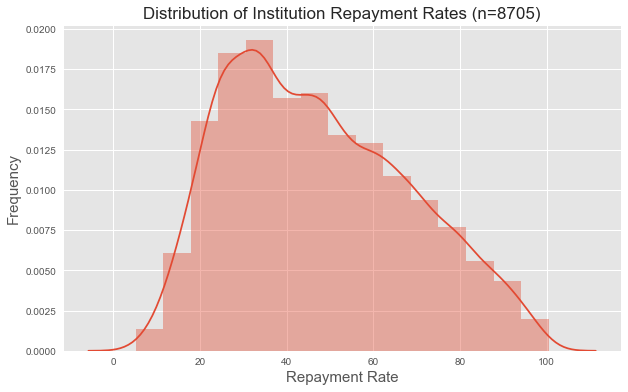

In [57]:
plt.figure(figsize=(10,6))
sns.distplot(df.repayment_rate, bins=15)
plt.title('Distribution of Institution Repayment Rates (n=8705)', size=17)
plt.xlabel('Repayment Rate', size=15)
plt.ylabel('Frequency', size=15)

In [18]:
display(df.repayment_rate.describe())

count    8705.000000
mean       47.370863
std        20.987642
min         5.162708
25%        30.228006
50%        44.855045
75%        62.622899
max       100.473631
Name: repayment_rate, dtype: float64

In [5]:
df['school__ownership'] = df['school__ownership'].astype('category')

## Repayment Rate by Institution Type
- Private_For-Profit < Public < Private_Non-Profit
- Main campuses have higher Repayment Rates except for Public institutions.

In [86]:
df.loc[:,['school__main_campus', 'repayment_rate']][df['school__main_campus'] == 'Not main campus'].describe()

,repayment_rate
count,2678.000000
mean,35.358713
std,16.239674
min,5.533908
25%,24.452150
50%,32.236335
75%,42.789622
max,98.740877


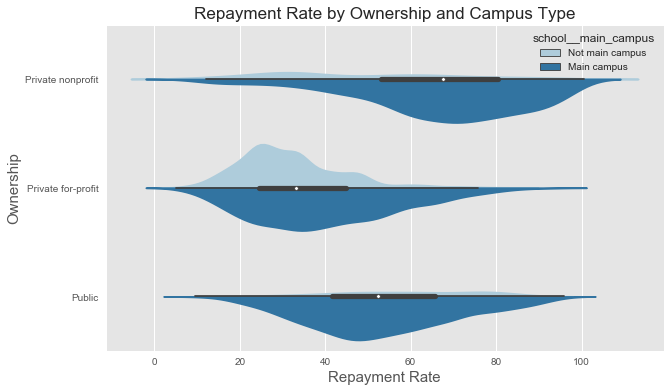

Count of Campus Types: 



school__main_campus,Main campus,Not main campus,All
school__ownership,,,
Private for-profit,2145,2180,4325
Private nonprofit,1773,275,2048
Public,2109,223,2332
All,6027,2678,8705


In [103]:
plt.figure(figsize=(10,6))
ax = sns.violinplot(x='repayment_rate', y="school__ownership", data=df,
                    hue='school__main_campus', 
                    split='True', 
                    inner='box',
                    scale='count',
                    palette='Paired')
ax.set_title('Repayment Rate by Ownership and Campus Type', size=17)
ax.set_ylabel('Ownership', size=15)
ax.set_xlabel('Repayment Rate', size=15)
plt.show()
print('Count of Campus Types: \n')
display(pd.crosstab(df.school__ownership, df.school__main_campus, margins=True))

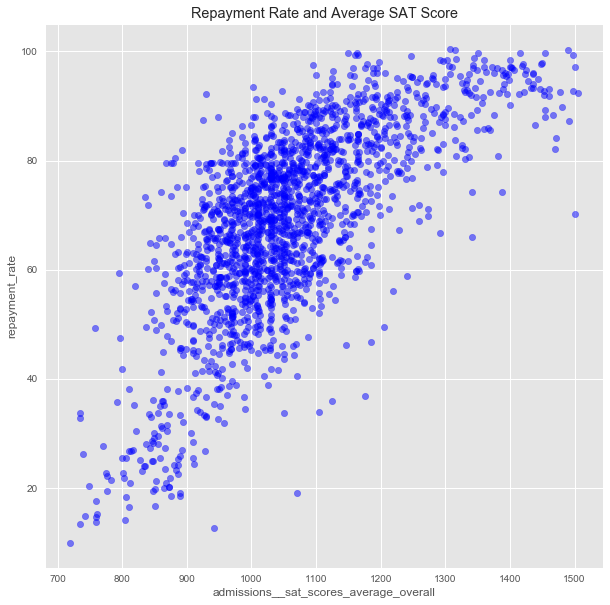

In [7]:
ax = df.plot.scatter(x='admissions__sat_scores_average_overall', y='repayment_rate', color='b', alpha=0.5, s=40, figsize=(10,10))
ax.set_title('Repayment Rate and Average SAT Score')
plt.show()


It looks like there is somewhat of a linear relationship between SAT Score and Repayment Rate. However, the residual plot for a simple linear model shows some structure. Mainly, there is less variation in Repayment Rate as SAT Score increases and there is slight downward trend along the x-axis.

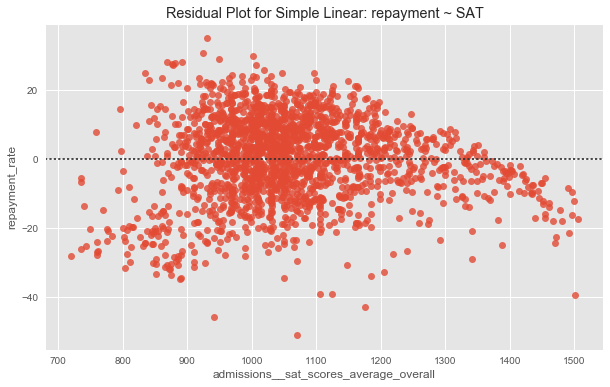

In [8]:
plt.figure(figsize=(10,6))
ax = sns.residplot(x='admissions__sat_scores_average_overall', y='repayment_rate', data=df)
ax.set_title('Residual Plot for Simple Linear: repayment ~ SAT')

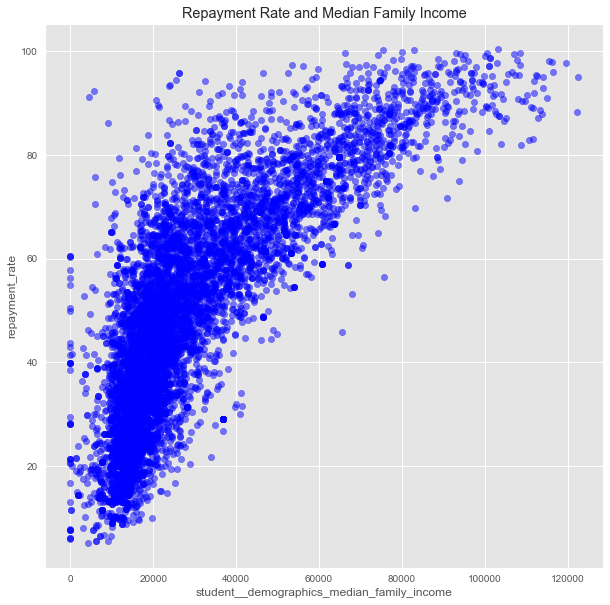

In [9]:
ax = df.plot.scatter(x='student__demographics_median_family_income', y='repayment_rate', color='b', alpha=0.5, s=40, figsize=(10,10))
ax.set_title('Repayment Rate and Median Family Income')
plt.show()

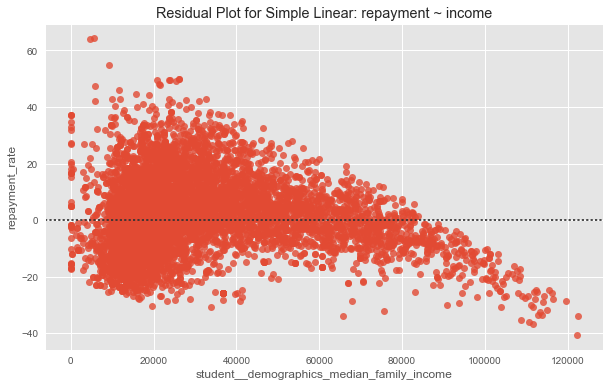

In [10]:
plt.figure(figsize=(10,6))
ax = sns.residplot(x='student__demographics_median_family_income', y='repayment_rate', data=df)
ax.set_title('Residual Plot for Simple Linear: repayment ~ income')

## Repayment Rates by Region

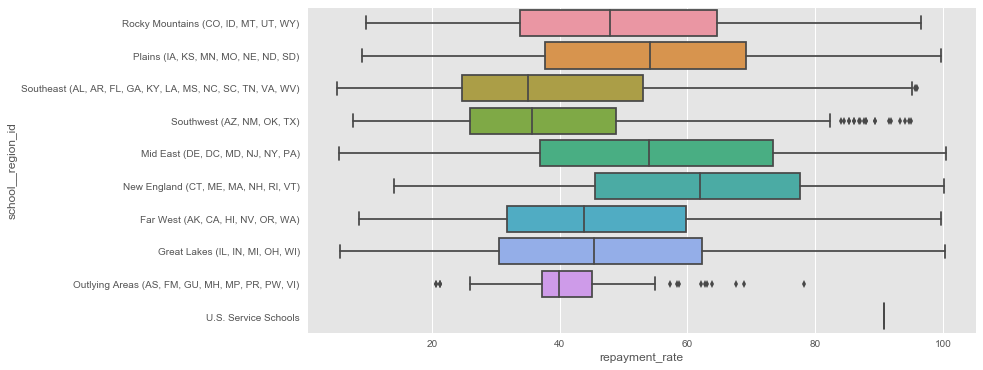

In [11]:
plt.figure(figsize=(12,6))
sns.boxplot(x='repayment_rate', y='school__region_id', data=df)


### Looks like there are a lot of missing values from admissions data, even though there is a strong linear relationship between test score and repayment rate.


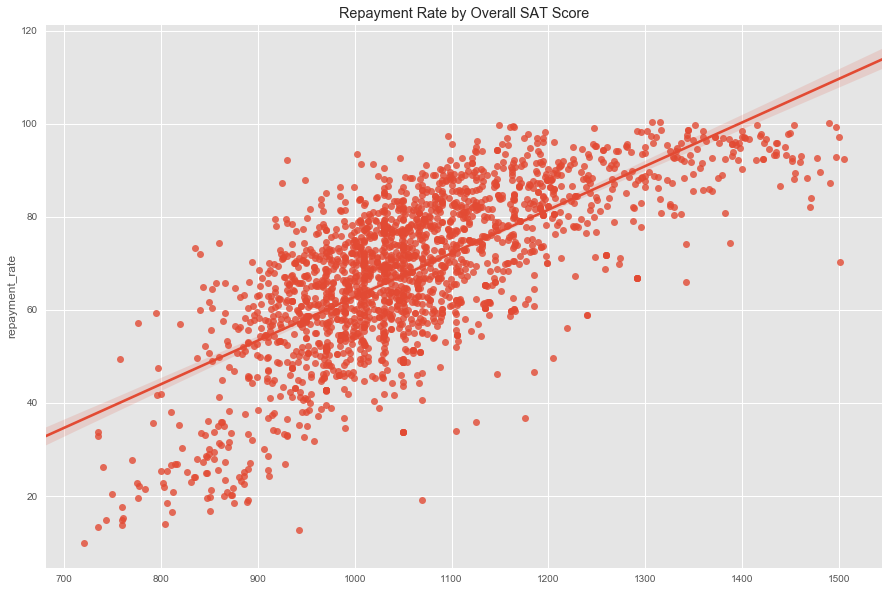

Number of Values in Each Column: 
admissions__sat_scores_average_by_ope_id                   2046
admissions__sat_scores_average_overall                     1889
admissions__act_scores_25th_percentile_cumulative          1808
admissions__act_scores_75th_percentile_cumulative          1808
admissions__act_scores_midpoint_cumulative                 1808
admissions__sat_scores_75th_percentile_math                1733
admissions__sat_scores_25th_percentile_math                1733
admissions__sat_scores_midpoint_math                       1733
admissions__sat_scores_midpoint_critical_reading           1708
admissions__sat_scores_75th_percentile_critical_reading    1708
admissions__sat_scores_25th_percentile_critical_reading    1708
admissions__act_scores_midpoint_english                    1566
admissions__act_scores_25th_percentile_math                1566
admissions__act_scores_midpoint_math                       1566
admissions__act_scores_75th_percentile_english             1566
admiss

In [12]:
plt.figure(figsize=(15,10))
ax = sns.regplot(x=df.filter(like='__sat_scores_average_by'), y=df.repayment_rate)
ax.set_title('Repayment Rate by Overall SAT Score')
plt.show()
admissions = []
admissions.extend(list(df.filter(regex=('__act'))))
admissions.extend(list(df.filter(regex=('__sat'))))
print('Number of Values in Each Column: \n{}'.format(df.loc[:,admissions].count().sort_values(ascending=False)))
print('Total Rows: {}'.format(df.shape[0]))


Number of Rows: 
admissions__admission_rate_by_ope_id    3362
dtype: int64


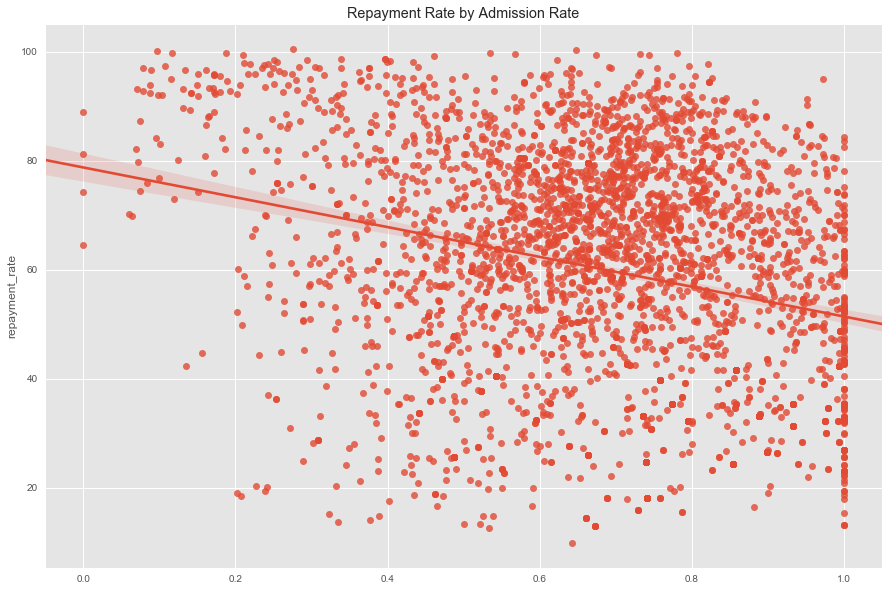

In [13]:
plt.figure(figsize=(15,10))
ax = sns.regplot(x=df.filter(like='admission_rate_by'), y=df.repayment_rate)
ax.set_title('Repayment Rate by Admission Rate')
print('Number of Rows: \n{}'.format(df.filter(like='admission_rate_by').count().sort_values(ascending=False)))

### Debt and Repayment Rate

In [14]:
print('Number of Values in Each Column: \n{}'.format(df.filter(like='_debt').count().sort_values(ascending=False)))


Number of Values in Each Column: 
aid__median_debt_number_overall                          8691
aid__cumulative_debt_number                              8691
aid__median_debt_number_non_first_generation_students    8630
aid__median_debt_number_first_generation_students        8630
aid__cumulative_debt_75th_percentile                     8593
aid__cumulative_debt_25th_percentile                     8593
aid__median_debt_number_income_0_30000                   8565
aid__median_debt_non_first_generation_students           8458
aid__median_debt_first_generation_students               8458
aid__median_debt_number_independent_students             8422
aid__median_debt_number_dependent_students               8422
aid__median_debt_number_noncompleters                    8415
aid__median_debt_number_completers                       8413
aid__median_debt_completers_monthly_payments             8360
aid__median_debt_completers_overall                      8360
aid__median_debt_income_0_30000     

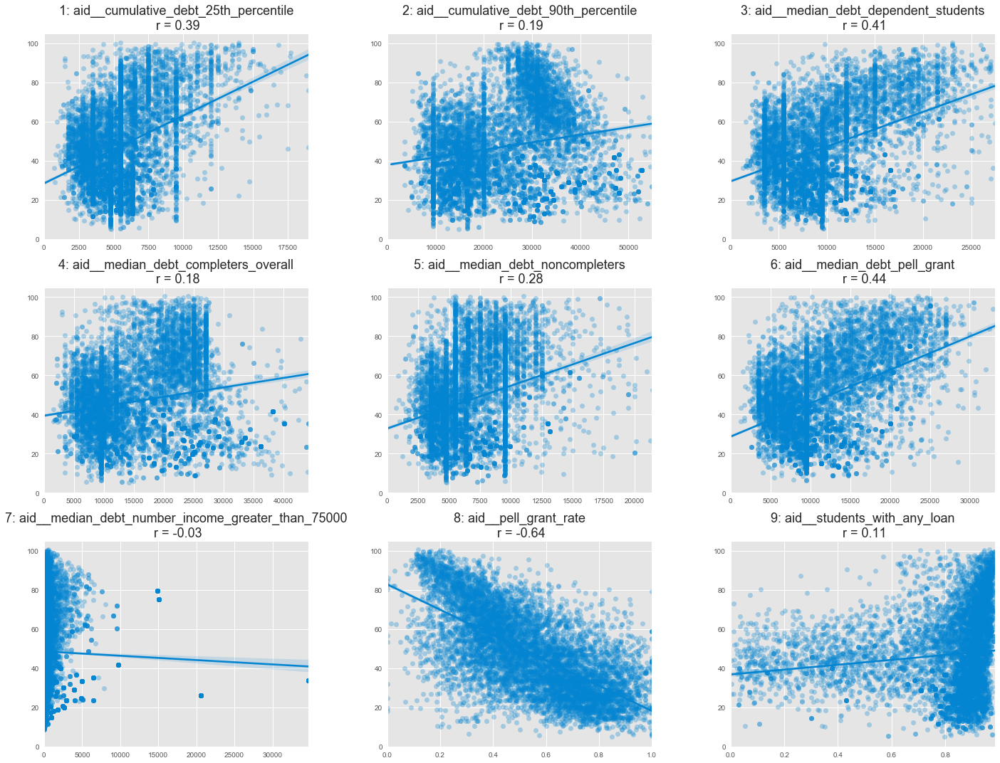

In [280]:
#temp = list(df.filter(like='_debt_'))
temp = ['aid__cumulative_debt_25th_percentile','aid__cumulative_debt_90th_percentile', 'aid__median_debt_dependent_students',
       'aid__median_debt_completers_overall', 'aid__median_debt_noncompleters', 'aid__median_debt_pell_grant',
        'aid__median_debt_number_income_greater_than_75000', 'aid__pell_grant_rate', 'aid__students_with_any_loan']
from sklearn.preprocessing import RobustScaler
scaler = RobustScaler()
fig, axes = plt.subplots(3, 3, figsize=(20,15))

ax = axes.ravel()

for i in range(len(temp)):
    #use this line for scaled data
    #ax[i].scatter(x=scaler.fit_transform(df[temp[i]].fillna(np.mean(df[temp[i]])).values.reshape(-1,1)), y=df['repayment_rate'], alpha=0.5)
    
    #use this line for original data
    #ax[i].scatter(x=df[temp[i]], y=df['repayment_rate'], alpha=0.5)
    sns.regplot(df[temp[i]], df['repayment_rate'], color='#0485d1', scatter_kws={'alpha':0.3}, ax=ax[i])
    ax[i].set_title('{0}: {1}\n r = {2:.2f}'.format(i+1, temp[i],stats.pearsonr(df[temp[i]].fillna(df[temp[i]].mean()),df['repayment_rate'])[0]),size=18)
    ax[i].set_xlim(0,df[temp[i]].quantile(q=0.999))
    ax[i].set_ylim(0,105)
    ax[i].xaxis.label.set_visible(False)
    ax[i].yaxis.label.set_visible(False)
fig.tight_layout()

Plot numbers 7,8,9,10,11,14,15,16,32 show *clear* linear correlation

I want to understand the separation in plots 2,3,5,6

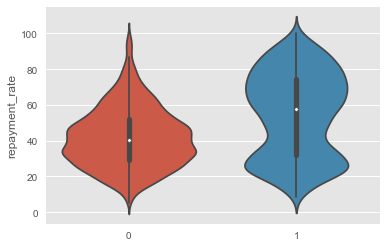

In [17]:
temp = ['aid__cumulative_debt_75th_percentile', 
        'aid__cumulative_debt_90th_percentile',
        'aid__median_debt_completers_monthly_payments', 
        'aid__median_debt_completers_overall'
       ]
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=2, random_state=0)
kmeans.fit(df.loc[:, temp].fillna(df.mean()))
labels = kmeans.labels_
sns.violinplot(y=df.repayment_rate, x=labels, scale='count')

In [342]:
df.loc[:,temp].notnull().sum()

admissions__admission_rate_overall            3023
admissions__act_scores_midpoint_cumulative    1808
admissions__sat_scores_average_by_ope_id      2046
dtype: int64

In [340]:
foo[0]

0.3472716829408386

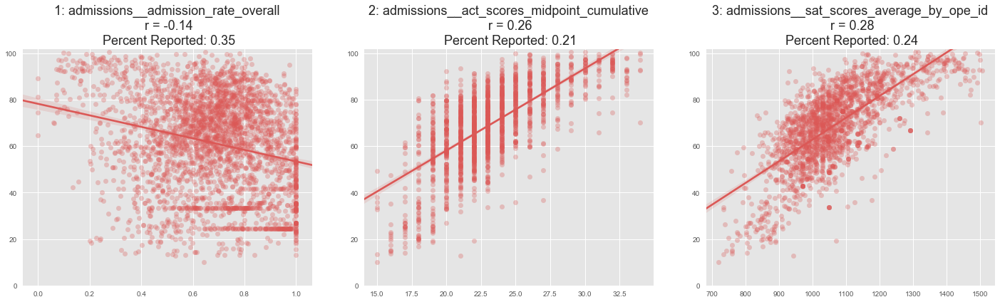

In [341]:
temp = ['admissions__admission_rate_overall', 'admissions__act_scores_midpoint_cumulative', 'admissions__sat_scores_average_by_ope_id']
foo = df.loc[:,temp].notnull().sum()/df.shape[0]
fig, axes = plt.subplots(1, 3, figsize=(20,6))
ax = axes.ravel()
for i in range(len(temp)):

    sns.regplot(df[temp[i]], df['repayment_rate'], color='#db5856', scatter_kws={'alpha':0.3}, ax=ax[i])
    ax[i].set_title('{0}: {1}\n r = {2:.2f}\n Percent Reported: {3:.2f}'.format(i+1, temp[i], 
                                            stats.pearsonr(df[temp[i]].fillna(df[temp[i]].mean()), df['repayment_rate'])[0], foo[i]),
                    size=18)
    #ax[i].set_xlim(-.01,1.01)
    ax[i].set_ylim(0,102)
    ax[i].xaxis.label.set_visible(False)
    ax[i].yaxis.label.set_visible(False)
fig.tight_layout()

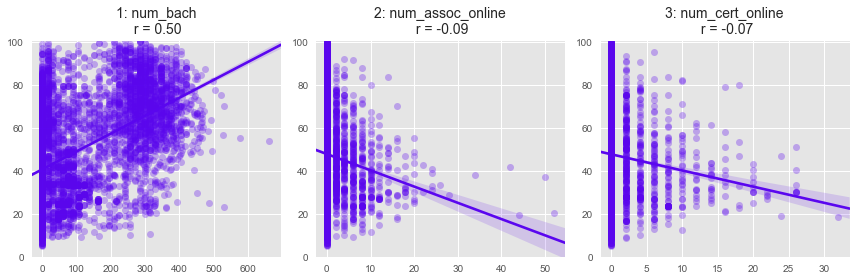

In [210]:
foo = pd.DataFrame({'num_bach':df.filter(like='_bach').replace([1,2],[2,1]).sum(axis=1).astype('int'),
                     'num_assoc_online':df.filter(like='_assoc')[df.filter(like='_assoc') == 2].sum(axis=1).astype('int'),
                     'num_cert_online':df.filter(like='_cert')[df.filter(like='_cert') == 2].sum(axis=1).astype('int')})
temp = ['num_bach', 'num_assoc_online', 'num_cert_online']

fig, axes = plt.subplots(1, 3, figsize=(12,4))
ax = axes.ravel()
for i in range(len(temp)):
    #use this line for scaled data
    #ax[i].scatter(x=scaler.fit_transform(df[temp[i]].fillna(np.mean(df[temp[i]])).values.reshape(-1,1)), y=df['repayment_rate'], alpha=0.5)
    
    #use this line for original data
    #ax[i].scatter(x=df[temp[i]], y=df['repayment_rate'], alpha=0.5)
    sns.regplot(foo[temp[i]], df['repayment_rate'], color='#5a06ef', scatter_kws={'alpha':0.3}, ax=ax[i])
    ax[i].set_title('{0}: {1}\n r = {2:.2f}'.format(i+1, temp[i], 
                                            stats.pearsonr(foo[temp[i]], df['repayment_rate'])[0]),
                    size=14)
    #ax[i].set_xlim(-.01,1.01)
    ax[i].set_ylim(0,101)
    ax[i].xaxis.label.set_visible(False)
    ax[i].yaxis.label.set_visible(False)
fig.tight_layout()

(0.49448708415093018, 0.0)

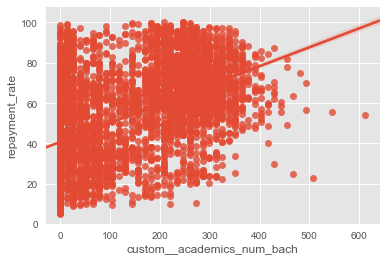

In [161]:
sns.regplot(df['custom__academics_num_bach'], df['repayment_rate'])
stats.pearsonr(df['custom__academics_num_bach'], df['repayment_rate'])

In [318]:
log_percentage = ['academics__program_percentage_english', 'academics__program_percentage_communication', 
                  'academics__program_percentage_social_science', 'academics__program_percentage_biological',
                 'academics__program_percentage_education']
for col in log_percentage:
    df['custom__log_{}'.format(col)] = df[col].map(lambda x: np.log(x*100+1))

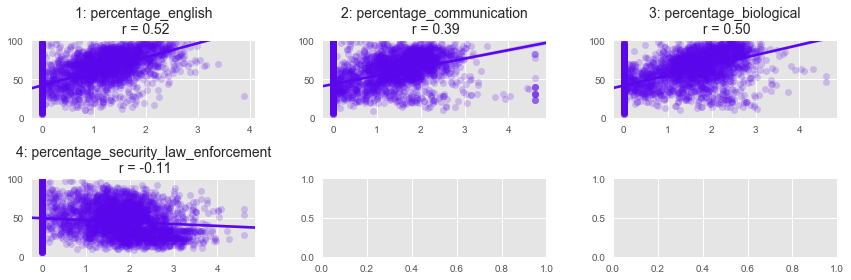

In [319]:

temp = ['custom__log_academics__program_percentage_english', 'custom__log_academics__program_percentage_communication',
                  'custom__log_academics__program_percentage_biological']

fig, axes = plt.subplots(2, 3, figsize=(12,4))

ax = axes.ravel()

for i in range(len(temp)):
    sns.regplot(df[temp[i]], df['repayment_rate'], color='#5a06ef', scatter_kws={'alpha':0.2}, ax=ax[i])
    ax[i].set_title('{0}: {1}\n r = {2:.2f}'.format(i+1, temp[i][31:],stats.pearsonr(df[temp[i]].fillna(df[temp[i]].mean()),df['repayment_rate'])[0]),size=14)
    
    #ax[i].set_xlim(-.01,1.01)
    ax[i].set_ylim(0,101)
    ax[i].xaxis.label.set_visible(False)
    ax[i].yaxis.label.set_visible(False)
fig.tight_layout()

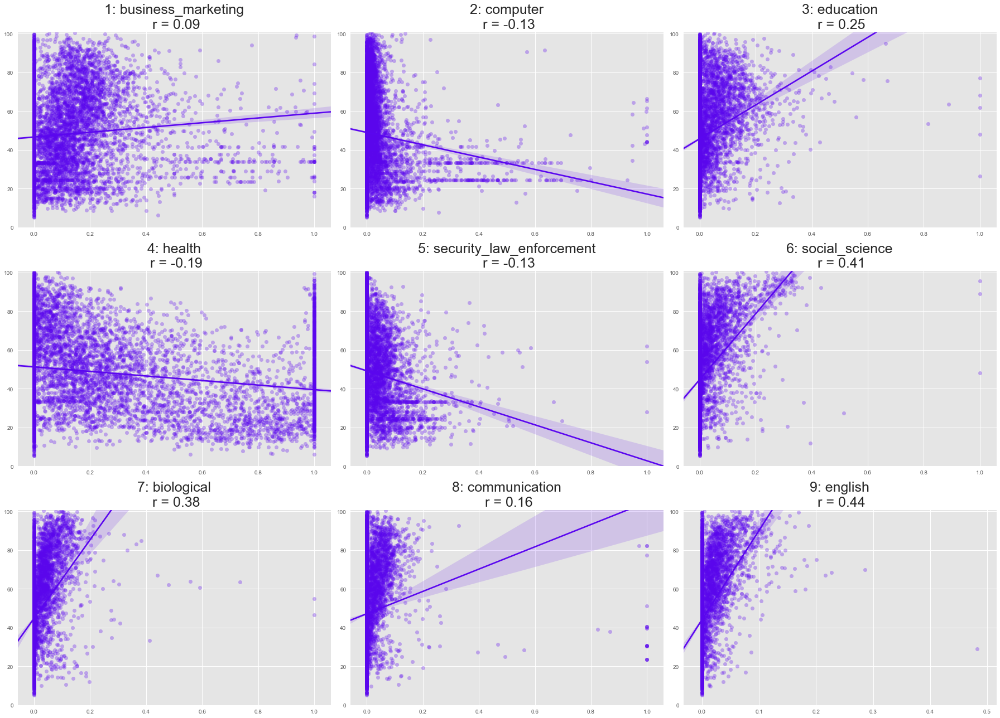

In [733]:
temp = list(df.filter(like='program_percentage'))
df['custom__academics_num_bach'] = df.filter(like='_bach').sum(axis=1).astype('int')
temp.append('custom__academics_num_bach')
temp = [
        'academics__program_percentage_business_marketing', 

       'academics__program_percentage_computer', 
        'academics__program_percentage_education', 
        
        'academics__program_percentage_health',
        'academics__program_percentage_security_law_enforcement', 
        'academics__program_percentage_social_science',
    'academics__program_percentage_biological', 
        'academics__program_percentage_communication',    
    'academics__program_percentage_english', 
       ]
from sklearn.preprocessing import RobustScaler
scaler = RobustScaler()
fig, axes = plt.subplots(3, 3, figsize=(25,18))

ax = axes.ravel()

for i in range(len(temp)):
    sns.regplot(df[temp[i]], df['repayment_rate'], color='#5a06ef', scatter_kws={'alpha':0.3}, ax=ax[i])
    ax[i].set_title('{0}: {1}\n r = {2:.2f}'.format(i+1, temp[i][30:],stats.pearsonr(df[temp[i]].fillna(df[temp[i]].mean()),df['repayment_rate'])[0]),size=25)
    
    #ax[i].set_xlim(-.01,1.01)
    ax[i].set_ylim(0,101)
    ax[i].xaxis.label.set_visible(False)
    ax[i].yaxis.label.set_visible(False)
fig.tight_layout()

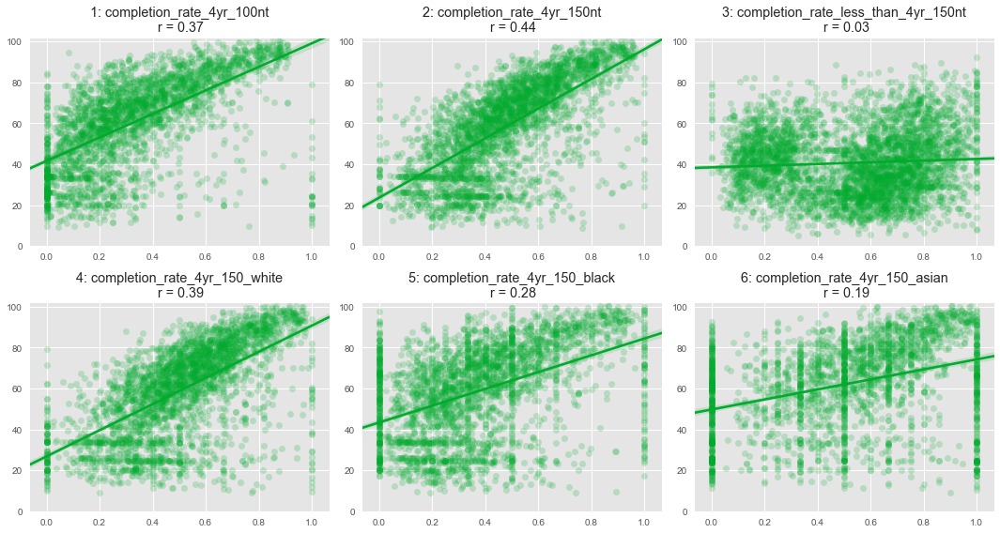

In [271]:
temp = list(df.filter(like='completion__'))
temp = ['completion__completion_rate_4yr_100nt', 'completion__completion_rate_4yr_150nt',  'completion__completion_rate_less_than_4yr_150nt',
        'completion__completion_rate_4yr_150_white', 'completion__completion_rate_4yr_150_black', 'completion__completion_rate_4yr_150_asian',]

fig, axes = plt.subplots(2, 3, figsize=(15,8))

ax = axes.ravel()

for i in range(len(temp)):
    sns.regplot(df[temp[i]], df['repayment_rate'], color='#02ab2e', scatter_kws={'alpha':0.2}, ax=ax[i])
    #ax[i].set_title('{0}: {1}'.format(i+1, temp[i][12:]), size=19)
    ax[i].set_title('{0}: {1}\n r = {2:.2f}'.format(i+1, temp[i][12:],stats.pearsonr(df[temp[i]].fillna(df[temp[i]].mean()),df['repayment_rate'])[0],size=18))
    #ax[i].set_xlim(-.01,1.01)
    ax[i].set_ylim(0,102)
    ax[i].xaxis.label.set_visible(False)
    ax[i].yaxis.label.set_visible(False)
fig.tight_layout()

In [348]:
foo.describe()

count    35.000000
mean      0.425073
std       0.183081
min       0.200345
25%       0.253877
50%       0.356692
75%       0.642677
max       0.649856
dtype: float64

(0.5600466569809005, 0.0)

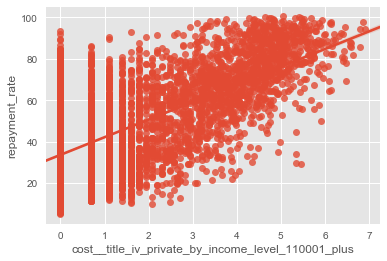

In [372]:
bar = df['cost__title_iv_private_by_income_level_110001_plus'].map(lambda x:np.log(x+1))
df['custom__log_cost__title_iv_private_by_income_level_110001_plus'] = bar

sns.regplot(bar, df['repayment_rate'])
#
stats.pearsonr(bar.fillna(bar.mean()), df['repayment_rate'])

(-0.10073200576369228, 4.4691541557486193e-21)

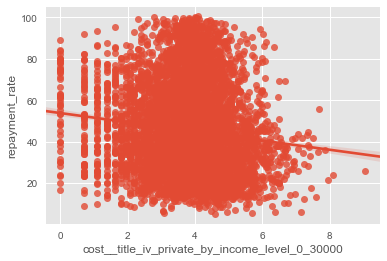

In [380]:
bar = df['cost__title_iv_private_by_income_level_0_30000'].map(lambda x:np.log(x+1))
#df['custom__log_cost__title_iv_private_by_income_level_0_30000'] = bar

sns.regplot(bar, df['repayment_rate'])
#
stats.pearsonr(bar.fillna(bar.mean()), df['repayment_rate'])

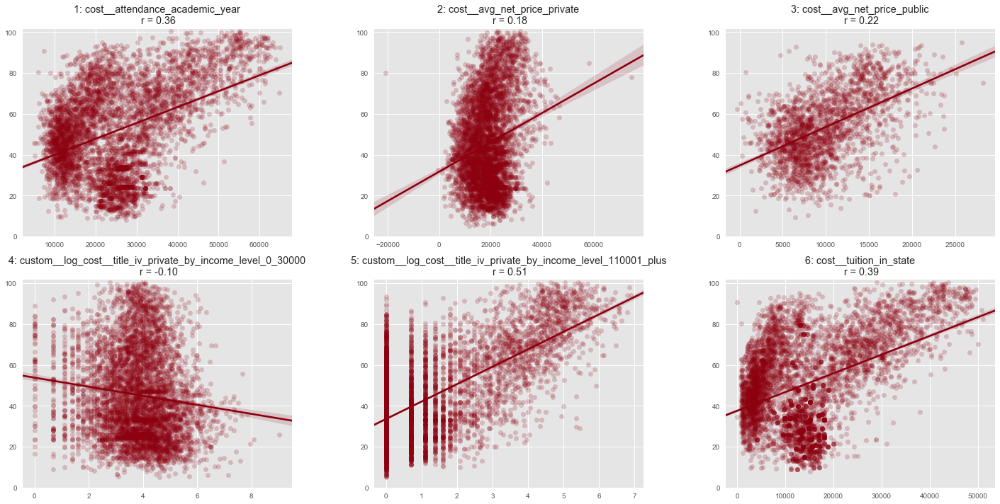

In [386]:
temp = ['cost__attendance_academic_year', 'cost__avg_net_price_private', 'cost__avg_net_price_public', 
        'custom__log_cost__title_iv_private_by_income_level_0_30000', 'custom__log_cost__title_iv_private_by_income_level_110001_plus', 
        'cost__tuition_in_state']
#temp = list(df.filter(like='cost__'))
fig, axes = plt.subplots(2, 3, figsize=(20,10))
foo = df.loc[:,temp].notnull().sum()/df.shape[0]


ax = axes.ravel()

for i in range(len(temp)):
    sns.regplot(df[temp[i]], df['repayment_rate'], color='#8c000f', scatter_kws={'alpha':0.2}, ax=ax[i])
    #ax[i].set_title('{0}: {1}'.format(i+1, temp[i][12:]), size=19)
    ax[i].set_title('{0}: {1}\n r = {2:.2f}'.format(i+1, temp[i],stats.pearsonr(df[temp[i]].fillna(df[temp[i]].median()),df['repayment_rate'])[0],size=20))
    #ax[i].set_title('{0}: {1}\n r = {2:.2f}\n Percent Reported: {3:.2f}'.format(i+1, temp[i], 
    #                                        stats.pearsonr(df[temp[i]].fillna(df[temp[i]].mean()), df['repayment_rate'])[0], foo[i]), size=18)
    #ax[i].set_xlim(-.01,1.01)
    ax[i].set_ylim(0,102)
    ax[i].xaxis.label.set_visible(False)
    ax[i].yaxis.label.set_visible(False)
fig.tight_layout()

In [800]:
list(df.filter(like="custom"))

['custom__academics_num_bach',
 'custom__religious_high',
 'custom__religious_low',
 'custom__school_state_low',
 'custom__school_state_high',
 'custom__school_region_low',
 'custom__school_region_high',
 'custom__carnegie_undergrad_four_year',
 'custom__carnegie_undergrad_two_year',
 'custom__carnegie_undergrad_low_transfer',
 'custom__carnegie_undergrad_high_transfer',
 'custom__carnegie_undergrad_part_time',
 'custom__carnegie_undergrad_full_time',
 'custom__carnegie_undergrad_inclusive',
 'custom__carnegie_undergrad_selective',
 'custom__carnegie_undergrad_low',
 'custom__carnegie_undergrad_high',
 'custom__school_carnegie_size_setting_high',
 'custom__school_carnegie_size_setting_low',
 'custom__carnegie_size_large',
 'custom__carnegie_size_medium',
 'custom__carnegie_size_small',
 'custom__carnegie_size_highly_residential',
 'custom__carnegie_size_primarily_residential',
 'custom__carnegie_basic_high',
 'custom__carnegie_basic_low',
 'custom__carnegie_basic_bacc',
 'custom__carne

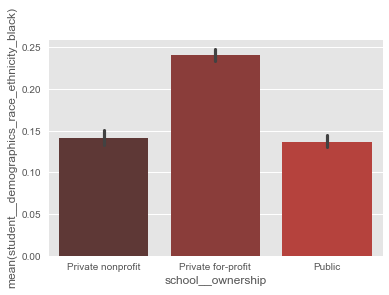

In [834]:
sns.set_palette('Reds_d')
sns.barplot('school__ownership', 'student__demographics_race_ethnicity_black', data=df)

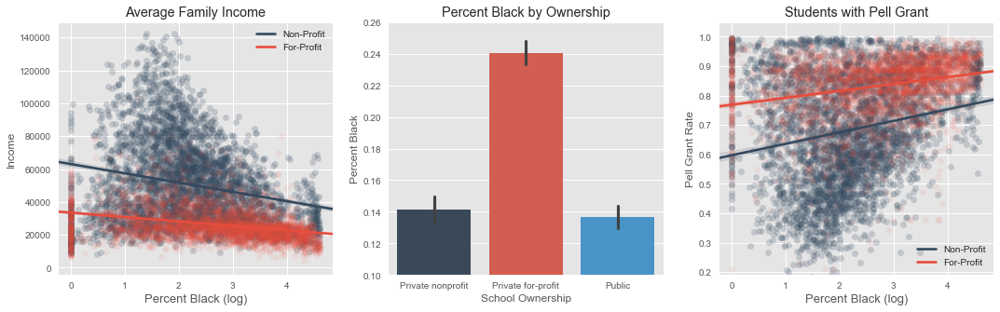

In [59]:
sns.set_palette([ "#34495e", '#e74c3c', "#3498db", "#9b59b6"])
fig, axes = plt.subplots(1, 3, figsize=(18,5))
ax = axes.ravel()
temp = ['student__demographics_avg_family_income', "cost__tuition_out_of_state", "student__students_with_pell_grant"]
df['custom__log_black'] = df['student__demographics_race_ethnicity_black'].map(lambda x: np.log(x*100+1))


titles = ['Average Family Income', "Out-of-State Tuition", "Students with Pell Grant"]
for i in [0,2]:
    sns.regplot('custom__log_black', temp[i], data=df[df.school__ownership != 'Private for-profit'], color='#34495e', ax=ax[i], scatter_kws={'alpha':0.2})
    ax[i].set_title('{0}'.format(titles[i]))
    ax[i].set_xlabel('Percentage of Black Students (log)', size=13)
    ax[i].set_ylabel("")

#ax[0].set_ylim(1000,14000)
ax[2].set_ylim(0.19,1.05)
#sns.regplot('custom__log_black', temp[1], data=df[df.school__ownership == 'Public'], color='red', ax=ax[1], scatter_kws={'alpha':0.2})
#sns.regplot('custom__log_black', temp[1], data=df[df.school__ownership == 'Private nonprofit'], color='purple', ax=ax[1], scatter_kws={'alpha':0.2})

#ax[1].set_title('Out-of-State Tuition')
#ax[1].legend(['Public', "Private Non-Profit"])
#ax[1].set_xlabel('Percentage of Black Students (log)', size=13)
#ax[1].set_ylabel("")
sns.barplot('school__ownership', 'student__demographics_race_ethnicity_black', data=df, ax=ax[1])
ax[1].set_title('Percent Black by Ownership')

ax[1].set_xlabel('School Ownership')
ax[1].set_ylim(0.1, 0.26)
sns.regplot('custom__log_black', temp[0], data=df[df.school__ownership == 'Private for-profit'], color='#e74c3c', ax=ax[0], scatter_kws={'alpha':0.08})
sns.regplot('custom__log_black', temp[2], data=df[df.school__ownership == 'Private for-profit'], color='#e74c3c', ax=ax[2], scatter_kws={'alpha':0.08})
ax[0].legend(['Non-Profit', "For-Profit"])
ax[2].legend(['Non-Profit', "For-Profit"])
ax[0].set_ylabel("Income")
ax[2].set_ylabel("Pell Grant Rate")
ax[0].set_xlabel('Percent Black (log)')
ax[2].set_xlabel('Percent Black (log)')

ax[1].set_ylabel('Percent Black')


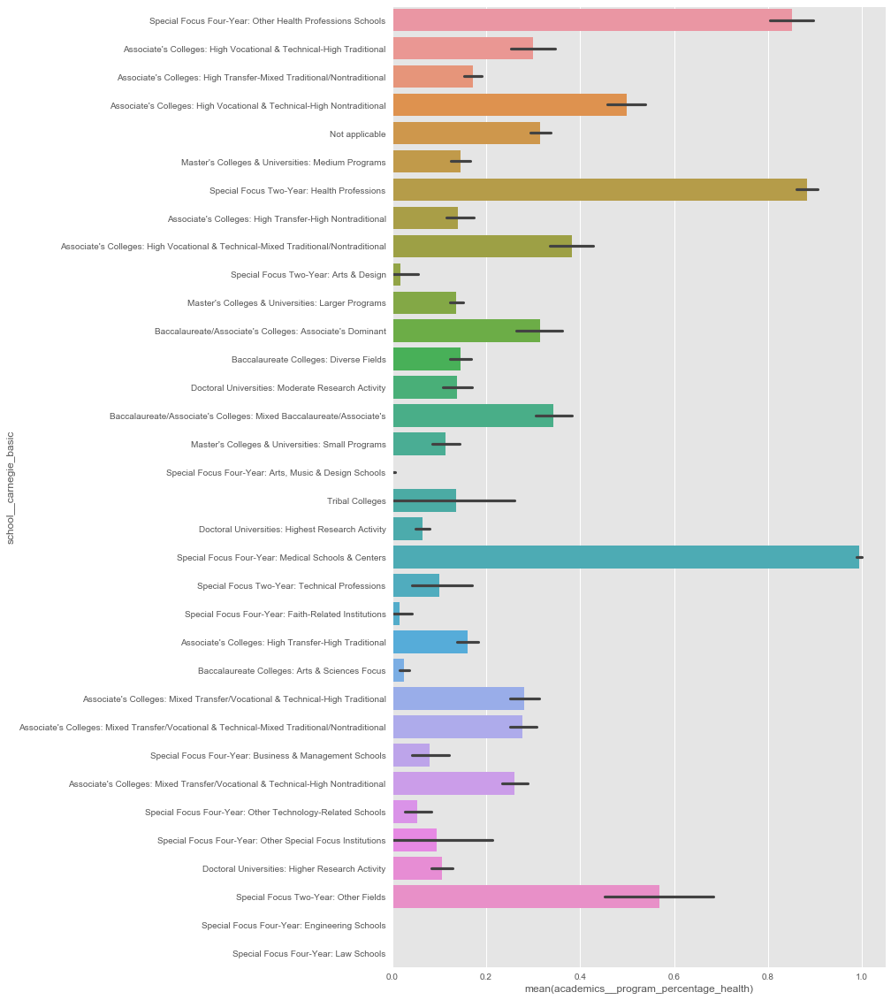

In [65]:
plt.figure(figsize=(10,20))
ax = sns.barplot('academics__program_percentage_health', 'school__carnegie_basic', data=df)


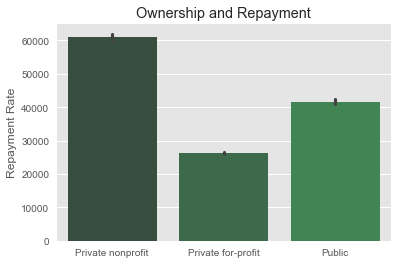

In [44]:

sns.set_palette('Greens_d')
ax = sns.barplot('school__ownership', 'student__demographics_avg_family_income', data=df)
ax.set_title("Ownership and Repayment")
ax.set_ylabel('Repayment Rate')
ax.set_xlabel("")
#ax.set_ylim(30, 68)

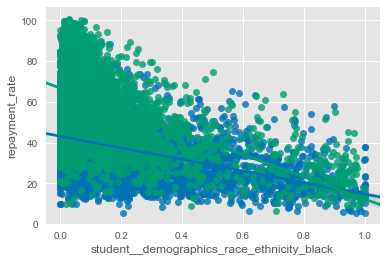

In [54]:
sns.set_palette('colorblind')
sns.regplot('student__demographics_race_ethnicity_black', 'repayment_rate', data=df[df.school__ownership == "Private for-profit"])
sns.regplot('student__demographics_race_ethnicity_black', 'repayment_rate', data=df[df.school__ownership != "Private for-profit"])

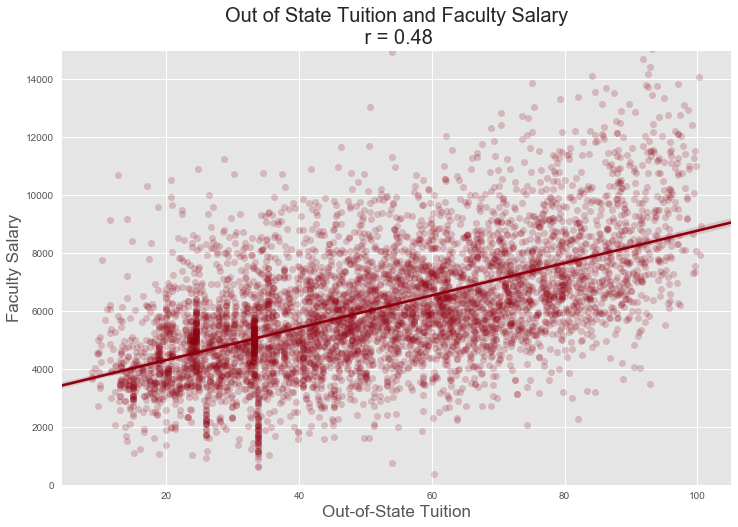

In [424]:
bar1 = df['repayment_rate']
bar2 = df['school__faculty_salary']
plt.figure(figsize=(12,8))
plt.title('Out of State Tuition and Faculty Salary\n r = {:.2f}'.format(stats.pearsonr(bar1.fillna(bar1.mean()), bar2.fillna(bar2.mean()))[0]),
         size=20)
plt.ylim(0,15000)

sns.regplot(bar1, bar2, color='#8c000f', scatter_kws={'alpha':0.2})
plt.ylabel('Faculty Salary', size=17)
plt.xlabel('Out-of-State Tuition', size=17)

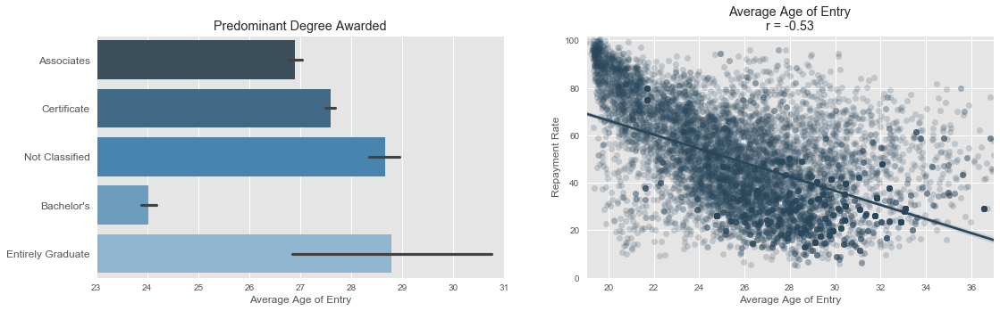

In [726]:
fig, axes = plt.subplots(1, 2, figsize=(18,5))
ax = axes.ravel()
sns.set_palette('husl')
sns.barplot('student__demographics_age_entry', "school__degrees_awarded_predominant", palette='Blues_d', ax=ax[0], data=df)
ax[0].set_xlim(23, 31)
sns.regplot('student__demographics_age_entry', "repayment_rate", ax=ax[1], color='#29465b', data=df, scatter_kws={'alpha':0.2})
ax[1].set_title('Average Age of Entry\nr = {:.2f}'.format(stats.pearsonr(df['student__demographics_age_entry'].fillna(df['student__demographics_age_entry'].mean()), 
                                                                         df['repayment_rate'])[0]))
ax[1].set_xlim(19,37)
ax[1].set_ylim(0,102)
ax[0].yaxis.label.set_visible(False)
ax[1].set_ylabel('Repayment Rate')
ax[0].set_title('Predominant Degree Awarded')
ax[0].set_yticklabels(['Associates', 'Certificate', 'Not Classified', "Bachelor's", 'Entirely Graduate'], size=12)
ax[0].set_xlabel("Average Age of Entry")
ax[1].set_xlabel("Average Age of Entry")


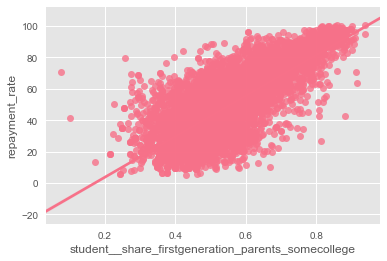

In [734]:
sns.regplot('student__share_firstgeneration_parents_somecollege', 'repayment_rate', data=df)

In [723]:
foo = df["school__degrees_awarded_predominant"]=='Entirely graduate-degree granting'
foo.sum()

52

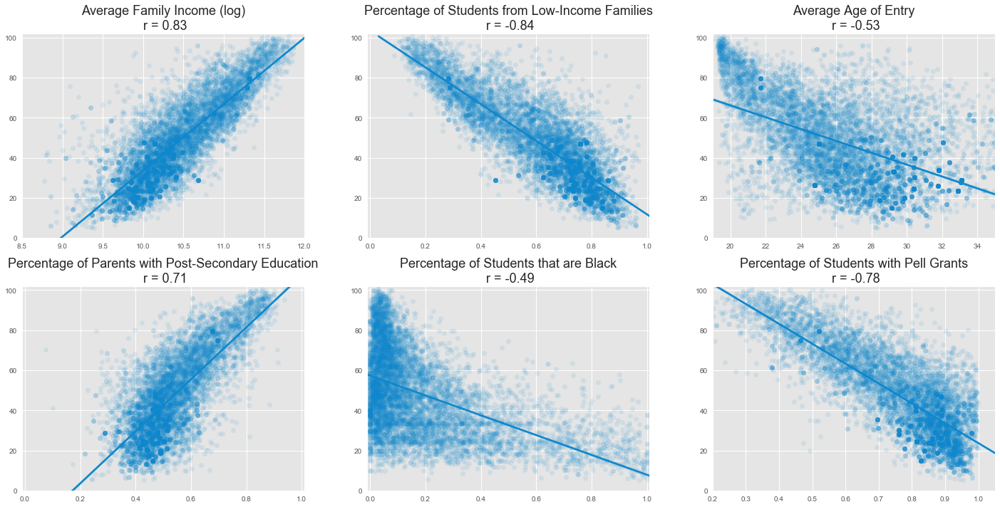

In [749]:
df["custom__log_student__avg_family_income"] = df['student__demographics_avg_family_income'].map(lambda x: np.log(x+1))
temp = ["custom__log_student__avg_family_income", "student__share_lowincome_0_30000", 
        'student__demographics_age_entry', "student__share_firstgeneration_parents_somecollege" ,
        "student__demographics_race_ethnicity_black", "student__students_with_pell_grant"]
titles = ['Average Family Income (log)', 'Percentage of Students from Low-Income Families', 
          "Average Age of Entry", "Percentage of Parents with Post-Secondary Education",'Percentage of Students that are Black',
         'Percentage of Students with Pell Grants']
fig, axes = plt.subplots(2,3, figsize=(20,10))
ax = axes.ravel()
for i in range(len(temp)):
    sns.regplot(df[temp[i]], df['repayment_rate'], scatter_kws={'alpha':0.1}, color='#0e87cc',ax=ax[i])
    ax[i].set_title('{0}\n r = {1:.2f}'.format(titles[i], 
                                            stats.pearsonr(df[temp[i]].fillna(df[temp[i]].mean()), df['repayment_rate'])[0]),
                    size=18)
    ax[i].set_xlim(-.01,1.01)
    ax[i].set_ylim(0,102)
    ax[i].xaxis.label.set_visible(False)
    ax[i].yaxis.label.set_visible(False)
ax[5].set_xlim(0.2,1.05) 
ax[2].set_xlim(19,35)  
ax[0].set_xlim(8.5,12)

fig.tight_layout()

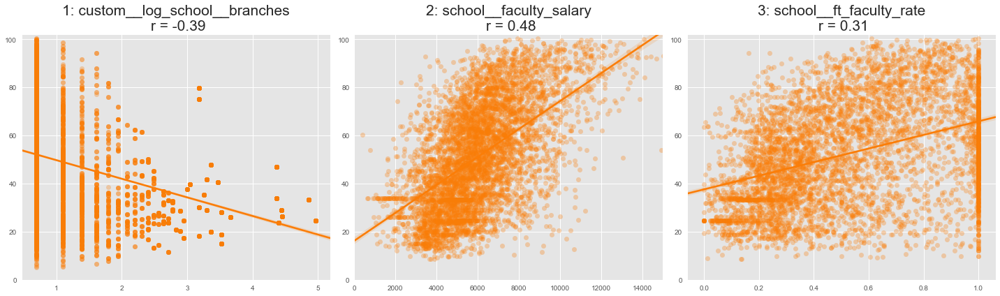

In [441]:
df["custom__log_school__branches"] = df['school__branches'].map(lambda x: np.log(x+1))
temp = ["custom__log_school__branches", "school__faculty_salary", "school__ft_faculty_rate"]
fig, axes = plt.subplots(1, 3, figsize=(20,6))
ax = axes.ravel()
for i in range(len(temp)):
    sns.regplot(df[temp[i]], df['repayment_rate'], color='#fb7d07', scatter_kws={'alpha':0.3}, ax=ax[i])
    ax[i].set_title('{0}: {1}\n r = {2:.2f}'.format(i+1, temp[i], 
                                            stats.pearsonr(df[temp[i]].fillna(df[temp[i]].mean()), df['repayment_rate'])[0]),
                    size=21)
    #ax[i].set_xlim(-.01,1.01)
    ax[i].set_ylim(0,102)
    ax[i].xaxis.label.set_visible(False)
    ax[i].yaxis.label.set_visible(False)
    ax[1].set_xlim(0, 15000)
fig.tight_layout()

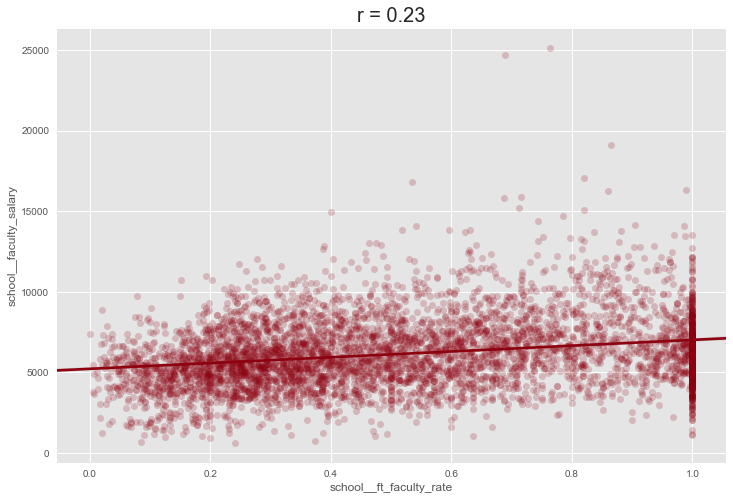

In [443]:
bar1 = df['school__ft_faculty_rate']
bar2 = df['school__faculty_salary']
plt.figure(figsize=(12,8))
plt.title('r = {:.2f}'.format(stats.pearsonr(bar1.fillna(bar1.mean()), bar2.fillna(bar2.mean()))[0]),
         size=20)
sns.regplot(bar1, bar2, color='#8c000f', scatter_kws={'alpha':0.2})


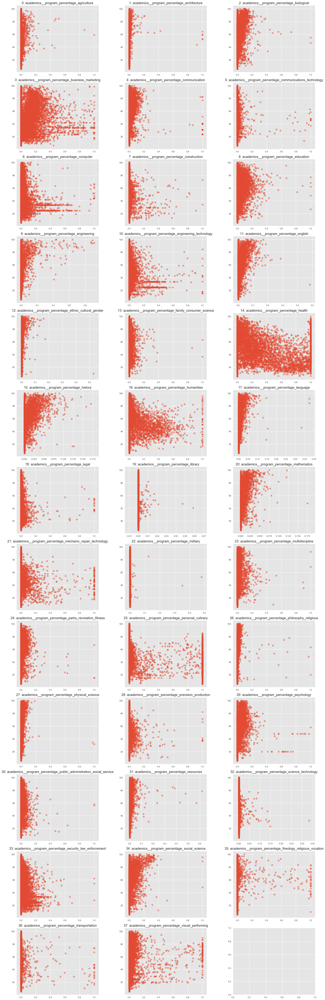

In [18]:
temp = list(df.filter(like='_program_percentage_'))
fig, axes = plt.subplots(13, 3, figsize=(20,60))
ax = axes.ravel()
for i in range(38): 
    #ax[i].scatter(x=df[temp[i]].replace([0,1], np.nan), y=df['repayment_rate'], alpha=0.5)
    ax[i].scatter(x=df[temp[i]], y=df['repayment_rate'], alpha=0.5)
    ax[i].set_title('{0}: {1}'.format(i,temp[i]))
fig.tight_layout()

Some relationships apparent with: 6, 9, 10, 11, 14, 15, 16, 33, 34

### Looks like there is a linear correlation between number of bachelors degrees offerered and repayment rate

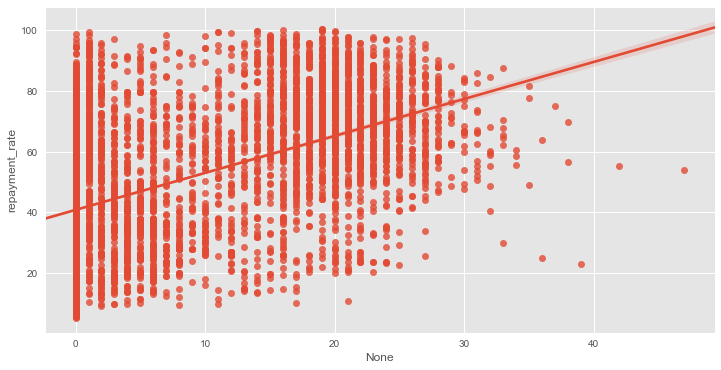

In [19]:
plt.figure(figsize=(12,6))
ax= sns.regplot(x=df.filter(like='_bach').replace(0,np.nan).sum(axis=1), y=df.repayment_rate)


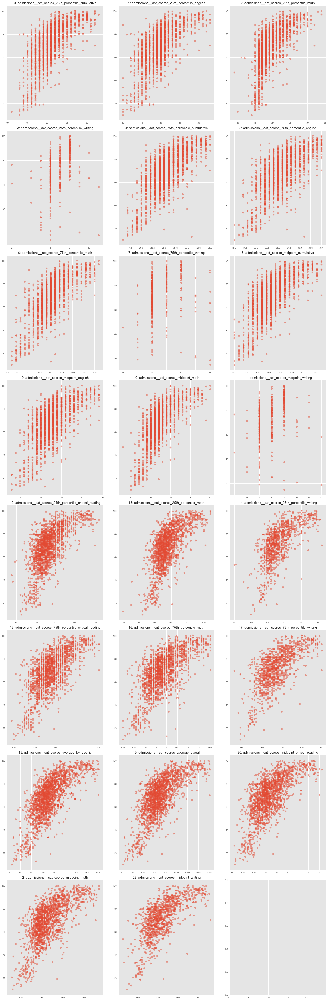

In [20]:
temp = list(df.filter(like='_scores_'))

fig, axes = plt.subplots(8, 3, figsize=(20,60))

ax = axes.ravel()

for i in range(len(temp)):
    #use this line for scaled data
    #ax[i].scatter(x=scaler.fit_transform(df[temp[i]].fillna(np.mean(df[temp[i]])).values.reshape(-1,1)), y=df['repayment_rate'], alpha=0.5)   
    #use this line for original data
    ax[i].scatter(x=df[temp[i]], y=df['repayment_rate'], alpha=0.5)
    ax[i].set_title('{0}: {1}'.format(i,temp[i]))    
fig.tight_layout()

The most **linear** relationships appear in plot numbers: 4,16

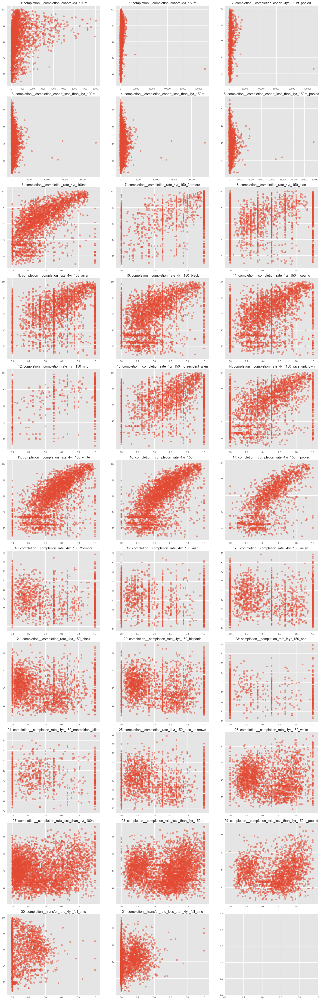

In [21]:
temp = list(df.filter(like='completion__'))

fig, axes = plt.subplots(11, 3, figsize=(20,60))

ax = axes.ravel()

for i in range(len(temp)):
    #use this line for scaled data
    #ax[i].scatter(x=scaler.fit_transform(df[temp[i]].fillna(np.mean(df[temp[i]])).values.reshape(-1,1)), y=df['repayment_rate'], alpha=0.5)   
    #use this line for original data
    ax[i].scatter(x=df[temp[i]], y=df['repayment_rate'], alpha=0.5)
    ax[i].set_title('{0}: {1}'.format(i,temp[i]))    
fig.tight_layout()

Linear relationships apparent in plot numbers: 6,9,10,11,13, 14, 15, 16, 17, but will need some editing for 0 and 1 values

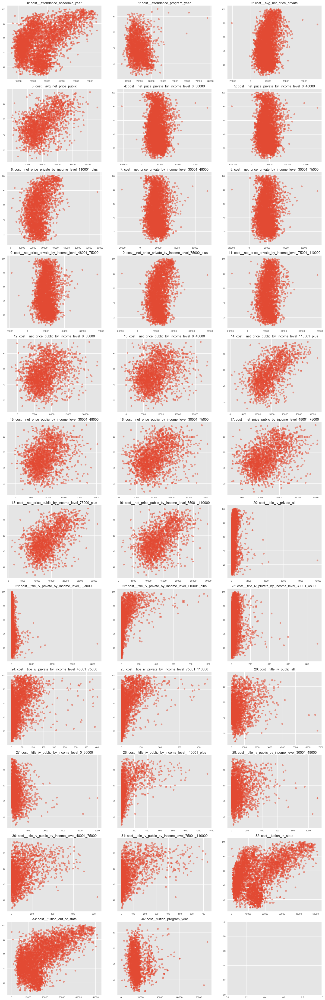

In [22]:
temp = list(df.filter(like='cost__'))

fig, axes = plt.subplots(12, 3, figsize=(20,60))

ax = axes.ravel()

for i in range(len(temp)):
    #use this line for scaled data
    #ax[i].scatter(x=scaler.fit_transform(df[temp[i]].fillna(np.mean(df[temp[i]])).values.reshape(-1,1)), y=df['repayment_rate'], alpha=0.5)   
    #use this line for original data
    ax[i].scatter(x=df[temp[i]], y=df['repayment_rate'], alpha=0.5)
    ax[i].set_title('{0}: {1}'.format(i,temp[i]))    
fig.tight_layout()

Clear linear relationships in plot numbers: 0, 3, 14, 18, 19, 25, 28, 30, 31, 32, 33

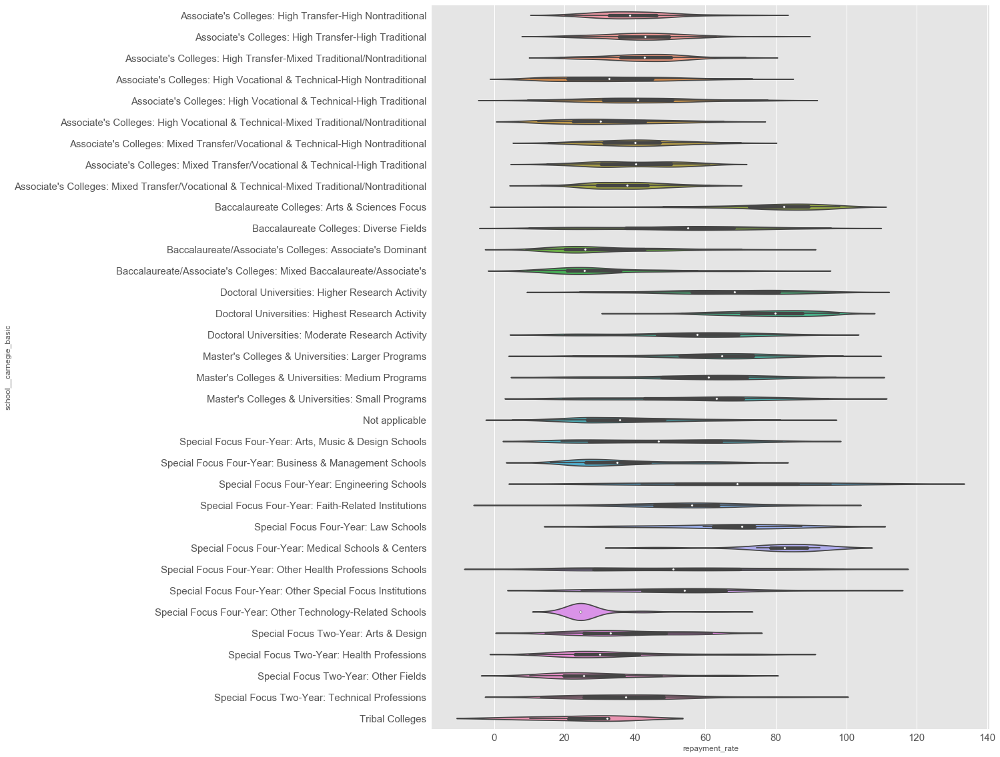

In [23]:
plt.figure(figsize=(15,20))
ax = sns.violinplot(y=df['school__carnegie_basic'].astype('category'), x='repayment_rate', data=df)
ax.tick_params(labelsize=15)

**Low:**
- Special Focus Four-Year: Other Technology-Related Schools
- Baccalaureate/Associate's Colleges: Associate's Dominant
- Baccalaureate/Associate's Colleges: Mixed Baccalaureate/Associates
- Special Focus Two-Year: Other Fields

**High:**
- Baccalaureate Colleges: Arts & Sciences Focus
- Special Focus Four-Year: Medical Schools & Centers
- Doctoral Universities: Highest Research Activity

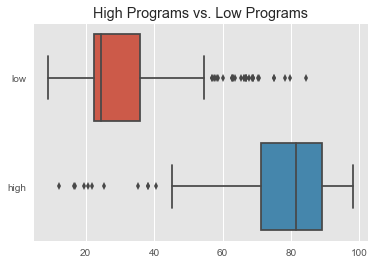

In [24]:
high_programs = ['Special Focus Four-Year: Medical Schools & Centers', 
                 'Doctoral Universities: Highest Research Activity',
                 'Baccalaureate Colleges: Arts & Sciences Focus']
low_programs = ['Special Focus Four-Year: Other Technology-Related Schools',
               "Baccalaureate/Associate's Colleges: Associate's Dominant",
               "Baccalaureate/Associate's Colleges: Mixed Baccalaureate/Associate's",
                'Special Focus Two-Year: Other Fields'               ]
df['high_programs'] = df.school__carnegie_basic.isin(high_programs).astype('int')
df['low_programs'] = df.school__carnegie_basic.isin(low_programs).astype('int')
ax = sns.boxplot(data = [df.repayment_rate[df['low_programs']==1], df.repayment_rate[df['high_programs']==1]], orient='h')
ax.set_title('High Programs vs. Low Programs')
ax.set_yticklabels(labels=['low', 'high'])

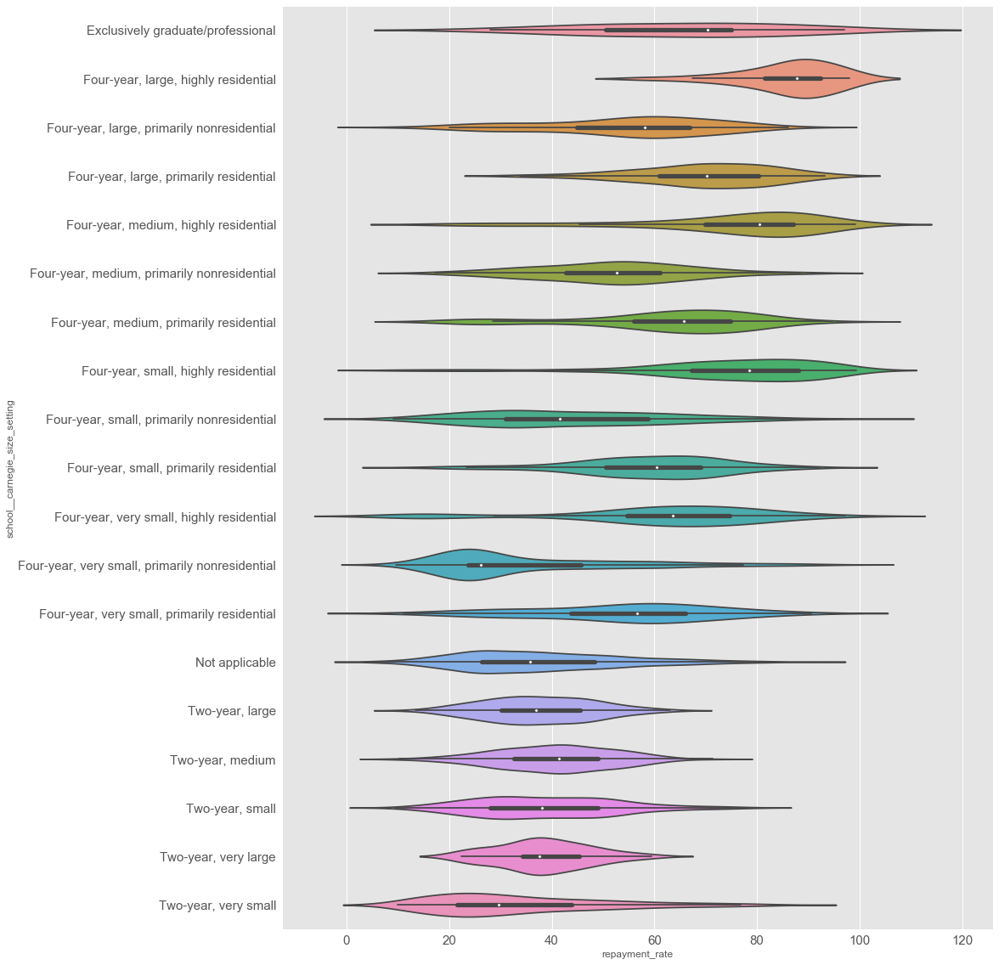

In [25]:
plt.figure(figsize=(15,20))
ax = sns.violinplot(y=df['school__carnegie_size_setting'].astype('category'), x='repayment_rate', data=df)
ax.tick_params(labelsize=15)

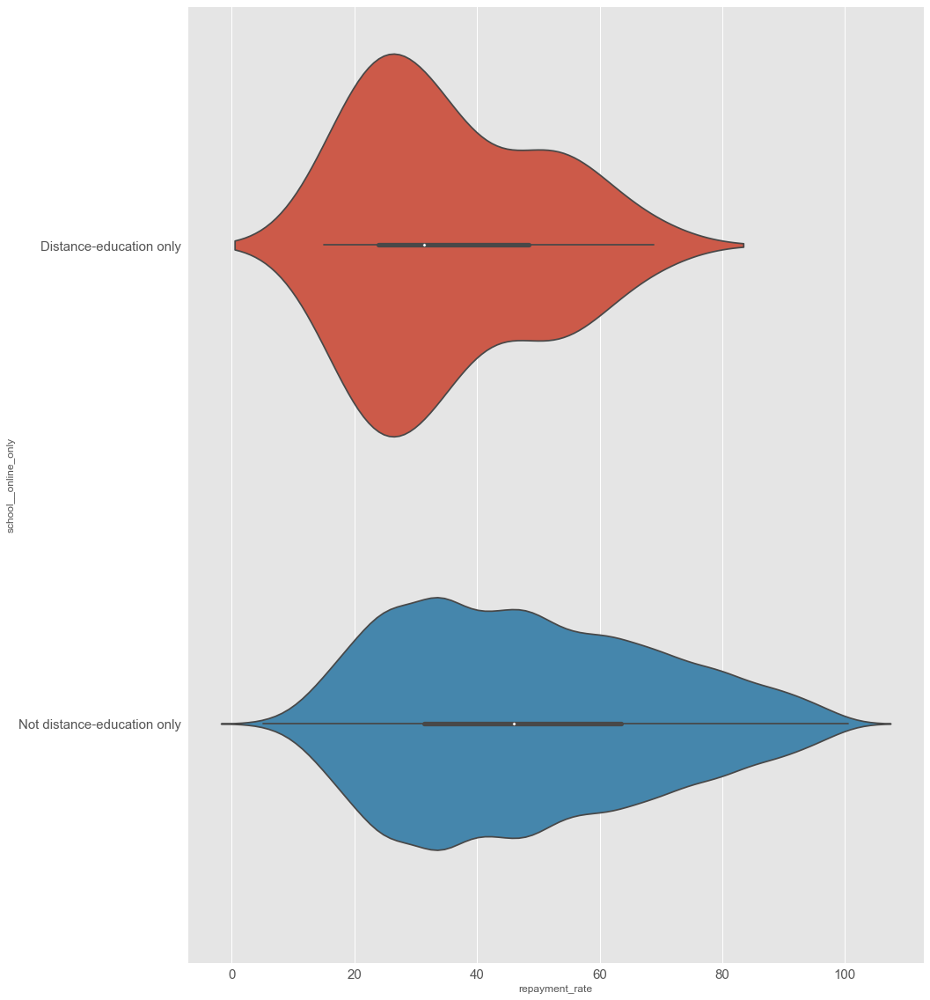

In [26]:
plt.figure(figsize=(15,20))
ax = sns.violinplot(y=df['school__online_only'].astype('category'), x='repayment_rate', data=df)
ax.tick_params(labelsize=15)

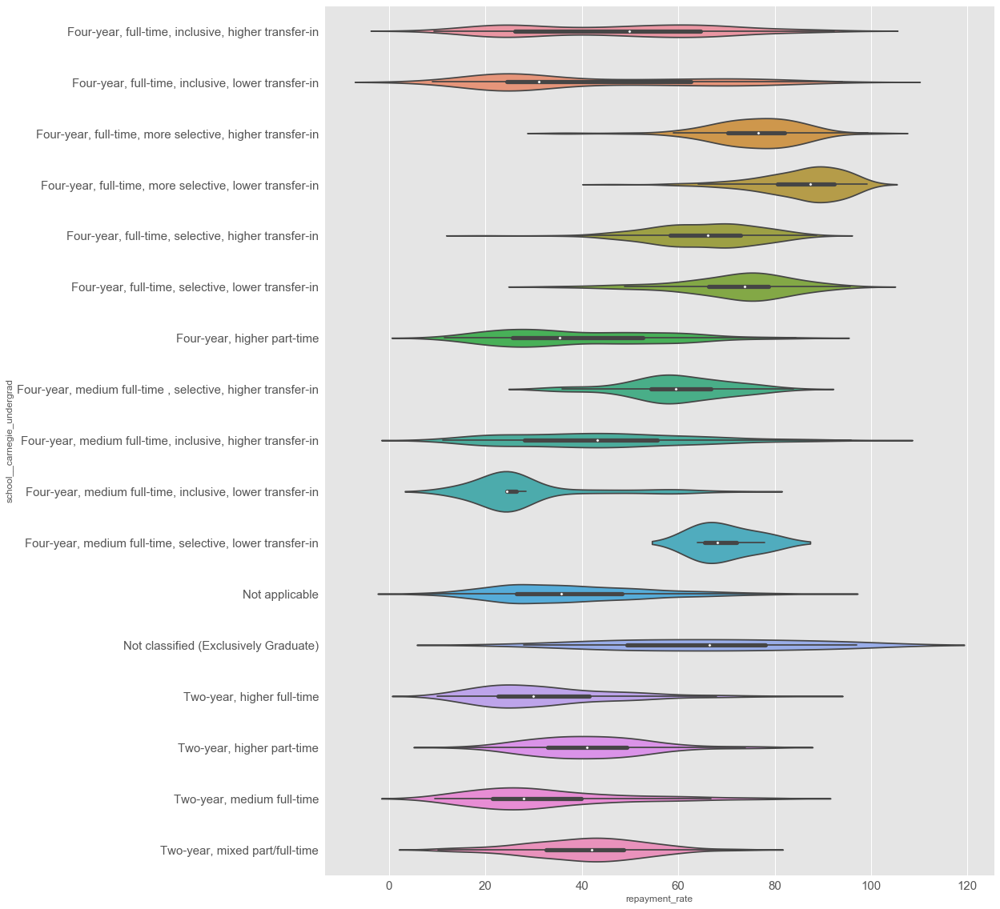

In [27]:
plt.figure(figsize=(15,20))
ax = sns.violinplot(y=df['school__carnegie_undergrad'].astype('category'), x='repayment_rate', data=df)
ax.tick_params(labelsize=15)

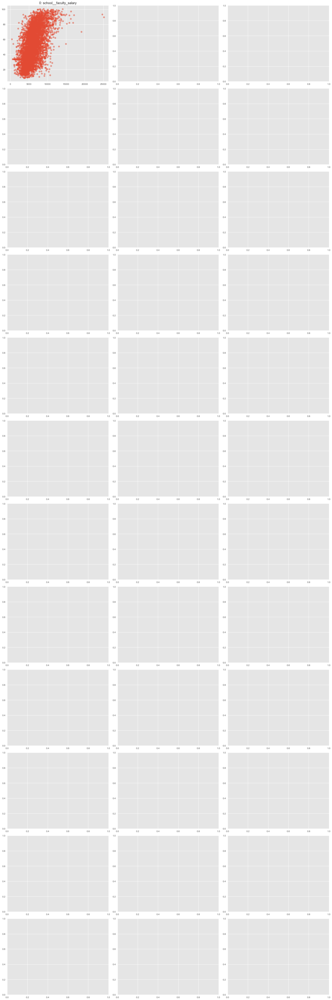

In [28]:
temp = list(df.filter(like='faculty_salary'))

fig, axes = plt.subplots(12, 3, figsize=(20,60))

ax = axes.ravel()

for i in range(len(temp)):
    #use this line for scaled data
    #ax[i].scatter(x=scaler.fit_transform(df[temp[i]].fillna(np.mean(df[temp[i]])).values.reshape(-1,1)), y=df['repayment_rate'], alpha=0.5)   
    #use this line for original data
    ax[i].scatter(x=df[temp[i]], y=df['repayment_rate'], alpha=0.5)
    ax[i].set_title('{0}: {1}'.format(i,temp[i]))    
fig.tight_layout()

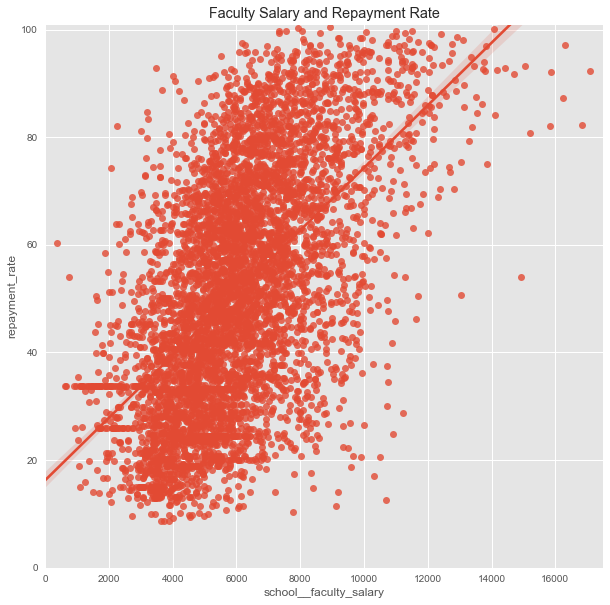

In [29]:
plt.figure(figsize=(10,10))
ax = sns.regplot(x='school__faculty_salary', y='repayment_rate', data=df)
ax.set_ylim(0, 101)
ax.set_xlim(0, 17500)
ax.set_title('Faculty Salary and Repayment Rate')

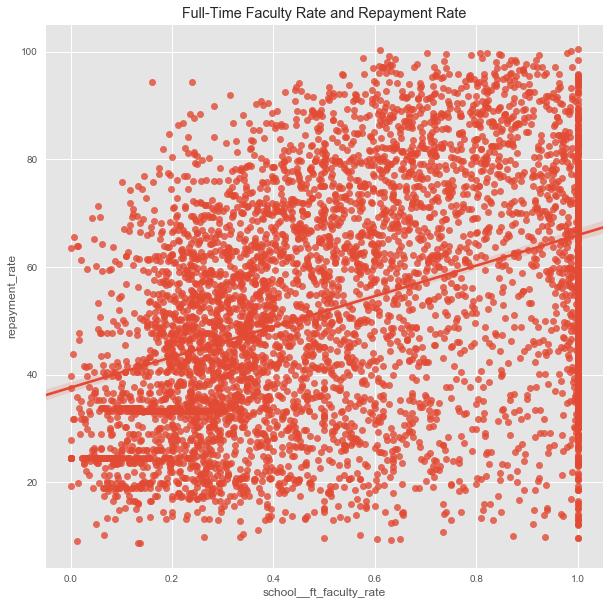

In [30]:
plt.figure(figsize=(10,10))
ax = sns.regplot(x='school__ft_faculty_rate', y='repayment_rate', data=df)
ax.set_title('Full-Time Faculty Rate and Repayment Rate')

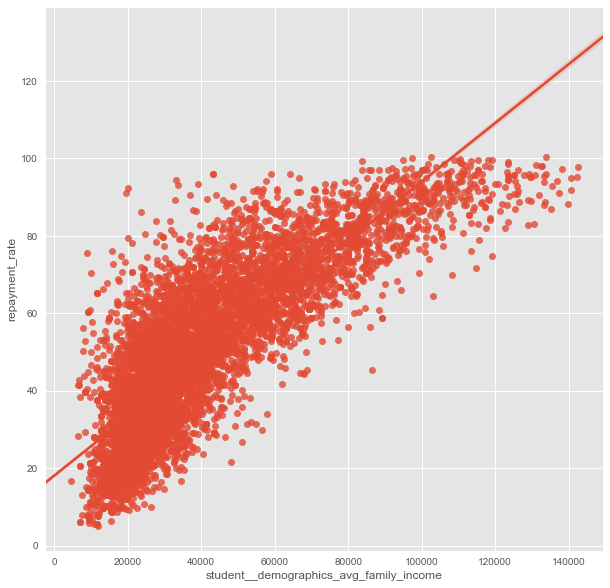

In [31]:
plt.figure(figsize=(10,10))
ax = sns.regplot(x='student__demographics_avg_family_income', y='repayment_rate', data=df)

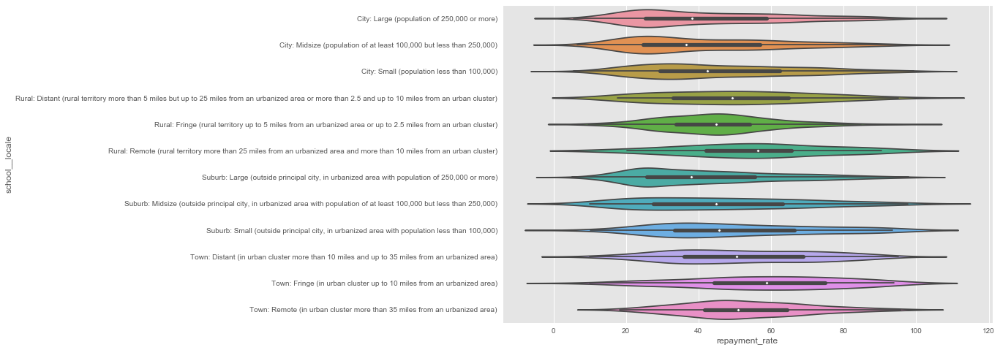

In [32]:
plt.figure(figsize=(12,8))
ax = sns.violinplot(y=df['school__locale'].astype('category'), x='repayment_rate', data=df)


In [33]:
for i in range(len(df['school__locale'].unique())):
    print('{0}: {1}'.format(i, df['school__locale'].unique()[i]))

0: Suburb: Large (outside principal city, in urbanized area with population of 250,000 or more)
1: nan
2: City: Small (population less than 100,000)
3: City: Large (population of 250,000 or more)
4: Town: Remote (in urban cluster more than 35 miles from an urbanized area)
5: City: Midsize (population of at least 100,000 but less than 250,000)
6: Town: Distant (in urban cluster more than 10 miles and up to 35 miles from an urbanized area)
7: Rural: Fringe (rural territory up to 5 miles from an urbanized area or up to 2.5 miles from an urban cluster)
8: Rural: Distant (rural territory more than 5 miles but up to 25 miles from an urbanized area or more than 2.5 and up to 10 miles from an urban cluster)
9: Suburb: Midsize (outside principal city, in urbanized area with population of at least 100,000 but less than 250,000)
10: Town: Fringe (in urban cluster up to 10 miles from an urbanized area)
11: Suburb: Small (outside principal city, in urbanized area with population less than 100,000)


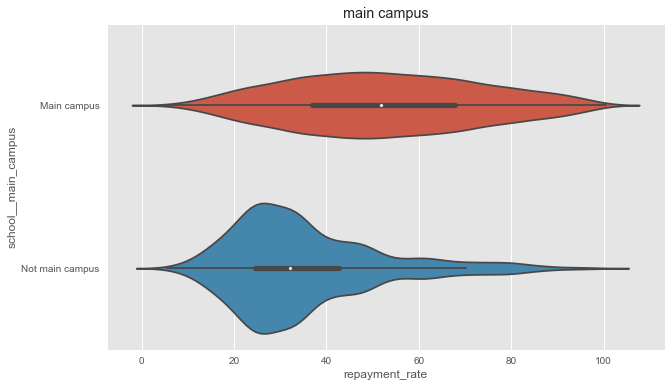

In [34]:
plt.figure(figsize=(10,6))
ax = sns.violinplot(y=df['school__main_campus'].astype('category'), x='repayment_rate', data=df)
ax.set_title('main campus')

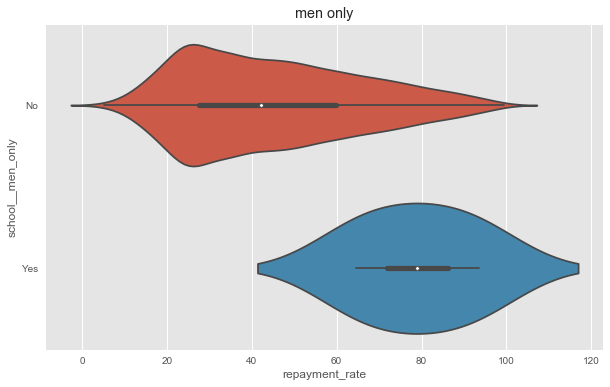

In [35]:
plt.figure(figsize=(10,6))
ax = sns.violinplot(y=df['school__men_only'].astype('category'), x='repayment_rate', data=df)
ax.set_title('men only')

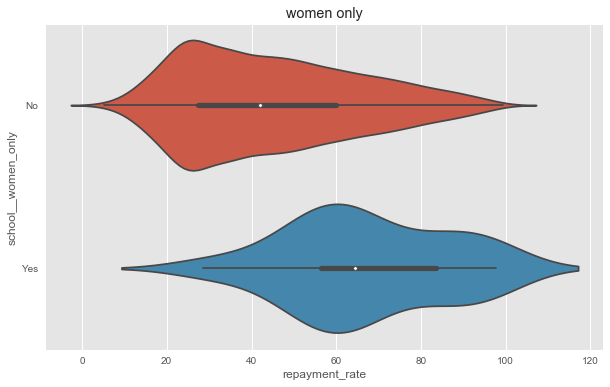

In [36]:
plt.figure(figsize=(10,6))
ax = sns.violinplot(y=df['school__women_only'].astype('category'), x='repayment_rate', data=df)
ax.set_title('women only')

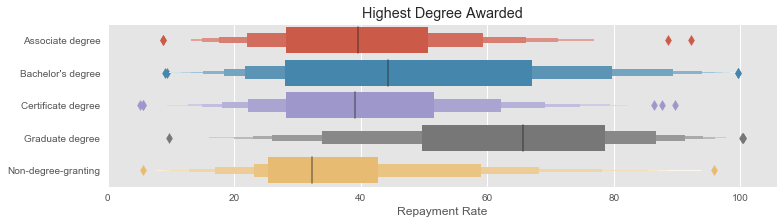

In [629]:
plt.figure(figsize=(12,3))
ax = sns.lvplot(y=df['school__degrees_awarded_highest'].astype('category'), x='repayment_rate', data=df)
ax.yaxis.label.set_visible(False)
ax.set_xlabel('Repayment Rate')
ax.set_title('Highest Degree Awarded')

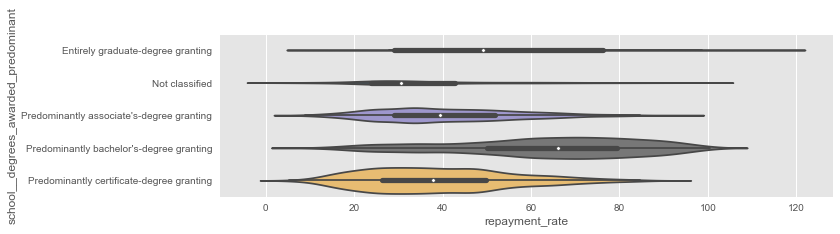

In [624]:
plt.figure(figsize=(11,3))
ax = sns.violinplot(y=df['school__degrees_awarded_predominant'].astype('category'), x='repayment_rate', data=df, scale='count')


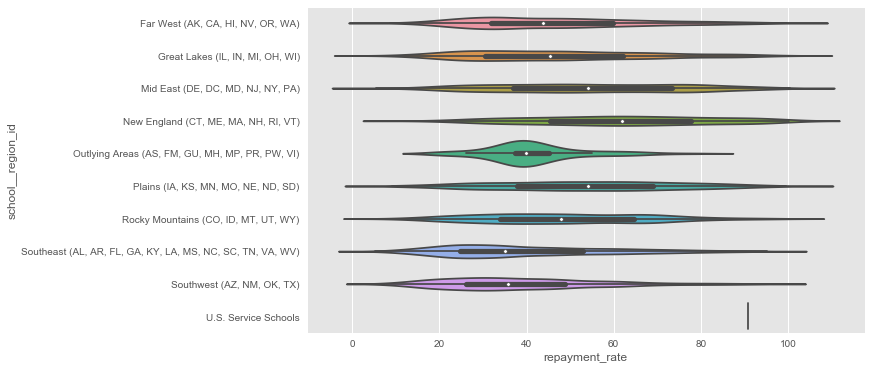

In [39]:
plt.figure(figsize=(10,6))
ax = sns.violinplot(y=df['school__region_id'].astype('category'), x='repayment_rate', data=df)

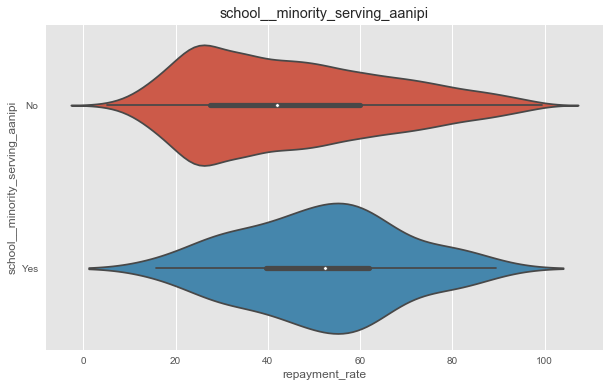

In [40]:
column = 'school__minority_serving_aanipi'
plt.figure(figsize=(10,6))
ax = sns.violinplot(y=df[column].astype('category'), x='repayment_rate', data=df)
ax.set_title(column)

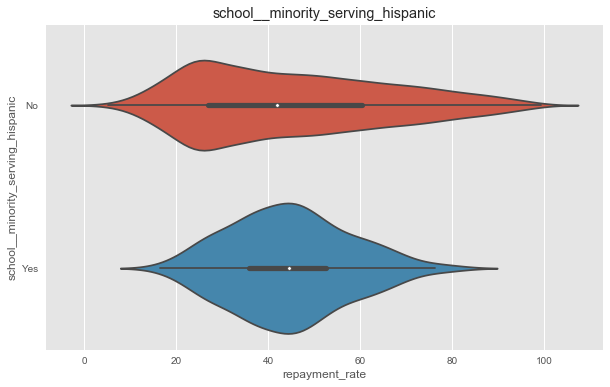

In [41]:
column = 'school__minority_serving_hispanic'
plt.figure(figsize=(10,6))
ax = sns.violinplot(y=df[column].astype('category'), x='repayment_rate', data=df)
ax.set_title(column)

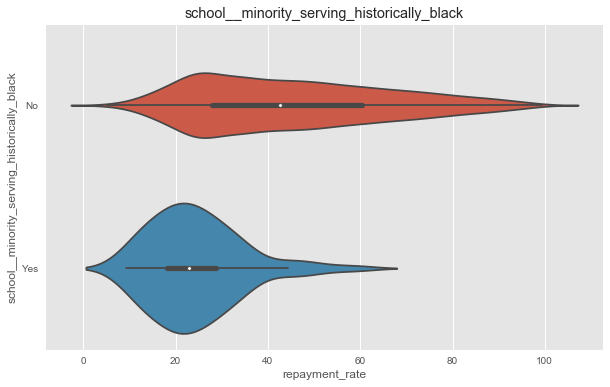

In [42]:
column = 'school__minority_serving_historically_black'
plt.figure(figsize=(10,6))
ax = sns.violinplot(y=df[column].astype('category'), x='repayment_rate', data=df)
ax.set_title(column)

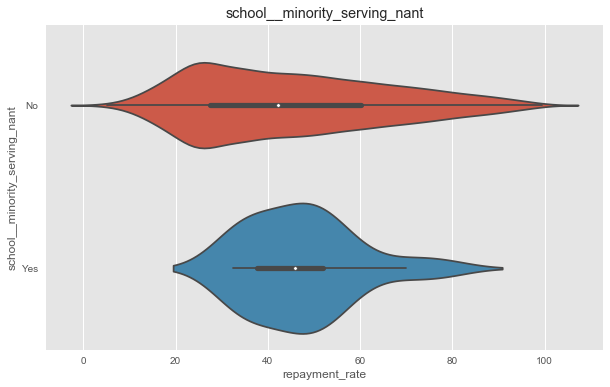

In [43]:
column = 'school__minority_serving_nant'
plt.figure(figsize=(10,6))
ax = sns.violinplot(y=df[column].astype('category'), x='repayment_rate', data=df)
ax.set_title(column)

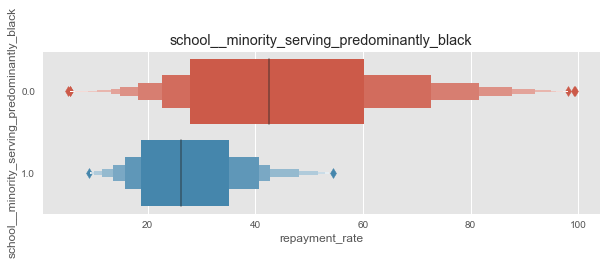

In [578]:
column = 'school__minority_serving_predominantly_black'
plt.figure(figsize=(10,3))
ax = sns.lvplot(y=df[column].astype('category'), x='repayment_rate', data=df)
ax.set_title(column)

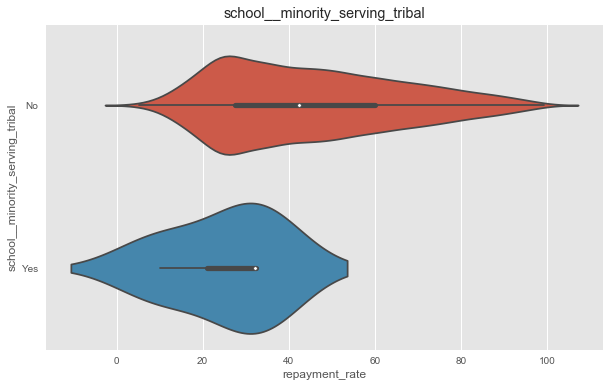

In [45]:
column = 'school__minority_serving_tribal'
plt.figure(figsize=(10,6))
ax = sns.violinplot(y=df[column].astype('category'), x='repayment_rate', data=df)
ax.set_title(column)

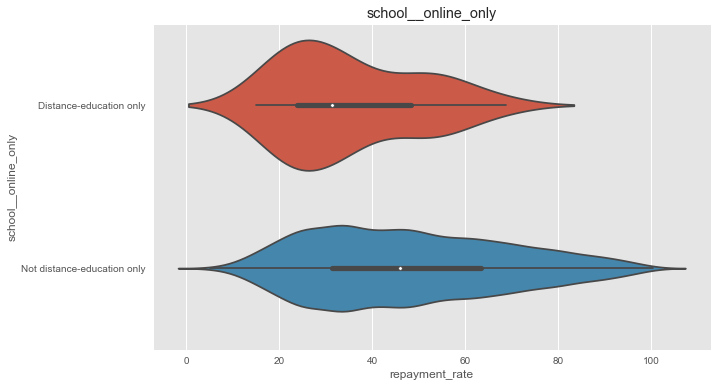

In [46]:
column = 'school__online_only'
plt.figure(figsize=(10,6))
ax = sns.violinplot(y=df[column].astype('category'), x='repayment_rate', data=df)
ax.set_title(column)

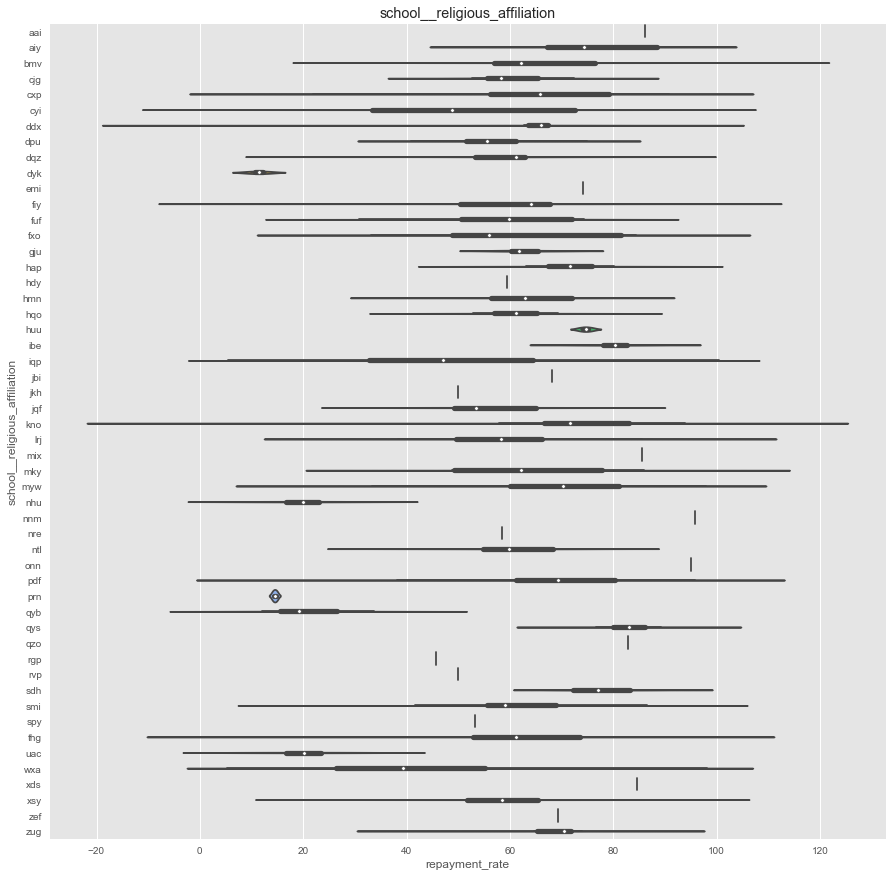

In [47]:
column = 'school__religious_affiliation'
plt.figure(figsize=(15,15))
ax = sns.violinplot(y=df[column].astype('category'), x='repayment_rate', data=df)
ax.set_title(column)

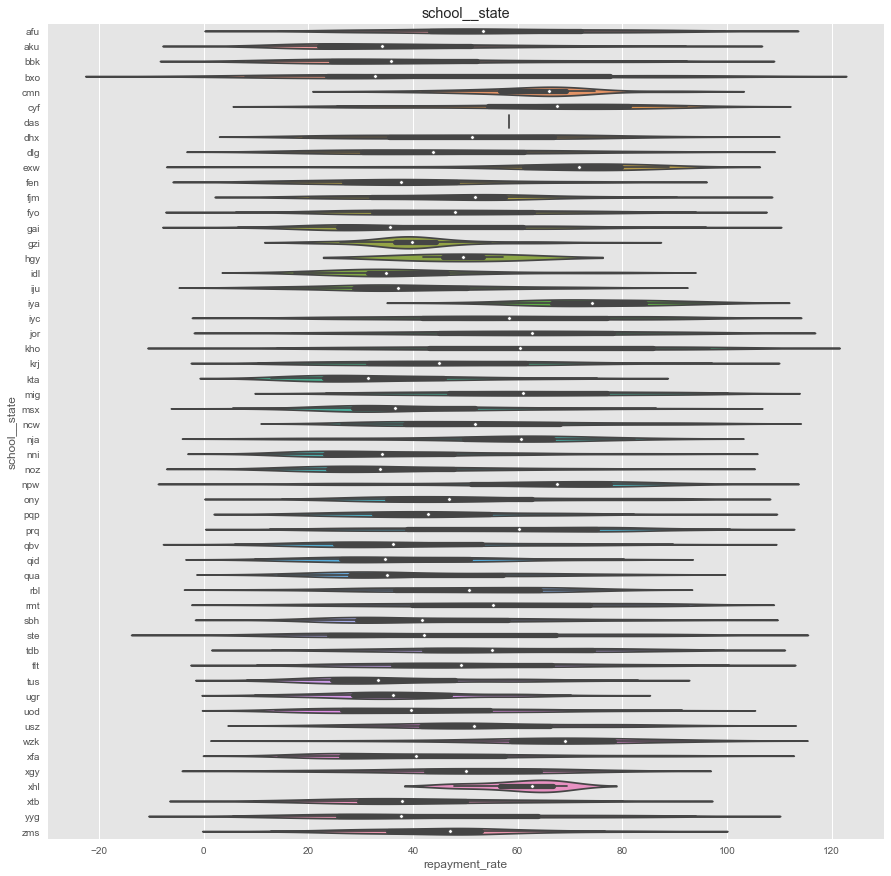

In [48]:
column = 'school__state'
plt.figure(figsize=(15,15))
ax = sns.violinplot(y=df[column].astype('category'), x='repayment_rate', data=df)
ax.set_title(column)

58


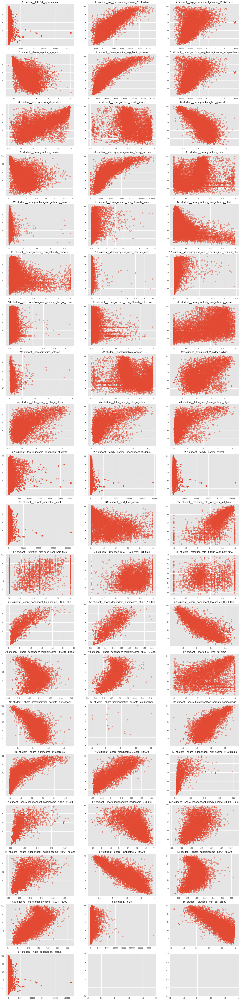

In [49]:
temp = list(df.filter(like='student__'))
print(len(temp))
fig, axes = plt.subplots(20, 3, figsize=(20,80))

ax = axes.ravel()

for i in range(len(temp)):
    #use this line for scaled data
    #ax[i].scatter(x=scaler.fit_transform(df[temp[i]].fillna(np.mean(df[temp[i]])).values.reshape(-1,1)), y=df['repayment_rate'], alpha=0.5)   
    #use this line for original data
    ax[i].scatter(x=df[temp[i]], y=df['repayment_rate'], alpha=0.5)
    ax[i].set_title('{0}: {1}'.format(i,temp[i]))    
fig.tight_layout()

In [503]:
def custom_cat(df):
    df = df.replace(['Yes', 'No'], [1,0]) #.fillna(0)
    df = df.replace(['Main campus', 'Not main campus'], [1,0]) #.fillna(0)
    
    df['custom__academics_num_bach'] = df.filter(like='_bach').replace([1,2],[2,1]).sum(axis=1).astype('int')
       
    df['custom__religious_high'] = df.school__religious_affiliation.isin(['myw','cxp','pdf','aiy','thg','zug','sdh','bmv','fxo','qys',
                                             'nnm','onn','ibe','ntl','smi','aai','huu','mix','dpu','fuf','dqz','hmn',
                                             'xds','qzo','mky','hap','fiy','gju','lrj','emi','ddx','jqf']).astype('int')
    df['custom__religious_low'] = df.school__religious_affiliation.isin(['wxa', 'prn', 'qyb', 'nhu','uac', 'rgp', 'iqp',]).astype('int')
    #df = df.drop(list(df.filter(like='school__religious_aff')), axis=1)
        
    df['custom__school_state_low'] = df.school__state.isin(['tus', 'nni','noz','ugr','aku','kta','qbv','iju','msx','qid','fen','bbk','sbh','uod',
                                           'gai','idl','gzi','xfa','qua','yyg','xtb','dlg','pgp','krj','bxo','zms','ste',]).astype('int')
    df['custom__school_state_high'] = df.school__state.isin(['prq', 'mig', 'tdb', 'iya', 'wzk', 'afu', 'iyc', 'exw', 'npw', 'rmt','jor','cyf','cmn','ncw','usz',
                                           'tlt','kho','xhl','dhx','nja','ony','rbl','xgy','fyo','das','fjm','hgy']).astype('int')
    #df = df.drop(list(df.filter(like='school__state')), axis=1)
    
    df['custom__school_region_low'] = df.school__region_id.isin(['Southwest (AZ, NM, OK, TX)', 
                                 'Southeast (AL, AR, FL, GA, KY, LA, MS, NC, SC, TN, VA, WV)',
                                 'Outlying Areas (AS, FM, GU, MH, MP, PR, PW, VI)',
                                ]).astype('int')
    df['custom__school_region_high'] = df.school__region_id.isin(['New England (CT, ME, MA, NH, RI, VT)',
                                'Mid East (DE, DC, MD, NJ, NY, PA)',
                                'Plains (IA, KS, MN, MO, NE, ND, SD)',
                                'U.S. Service Schools']).astype('int')
    #df = df.drop(list(df.filter(like='school__region')), axis=1)
    
    df['custom__carnegie_undergrad_four_year'] = df.school__carnegie_undergrad.str.contains('Four', na=False).astype('int')
    df['custom__carnegie_undergrad_two_year'] = df.school__carnegie_undergrad.str.contains('Two', na=False).astype('int')
    df['custom__carnegie_undergrad_low_transfer'] = df.school__carnegie_undergrad.str.contains('lower', na=False).astype('int')
    df['custom__carnegie_undergrad_high_transfer'] = df.school__carnegie_undergrad.str.contains('higher', na=False).astype('int')
    df['custom__carnegie_undergrad_part_time'] = df.school__carnegie_undergrad.str.contains(' part', na=False).astype('int')
    df['custom__carnegie_undergrad_full_time'] = df.school__carnegie_undergrad.str.contains(' full', na=False).astype('int')   
    df['custom__carnegie_undergrad_inclusive'] = df.school__carnegie_undergrad.str.contains('inclusive', na=False).astype('int')
    df['custom__carnegie_undergrad_selective'] = df.school__carnegie_undergrad.str.contains('selective', na=False).astype('int')

    df['custom__carnegie_undergrad_low'] = df.school__carnegie_undergrad.isin(['Four-year, full-time, inclusive, lower transfer-in', 
                                         'Four-year, higher part-time',
                                         'Four-year, medium full-time, inclusive, lower transfer-in',
                                         'Two-year, medium full-time',
                                         'Two-year, higher full-time',
                                         'Not applicable',
                                         'Two-year, mixed part/full-time',
                                         'Four-year, medium full-time, inclusive, higher transfer-in',
                                         'Two-year, higher part-time',]).astype('int')
    df['custom__carnegie_undergrad_high'] = df.school__carnegie_undergrad.isin(['Four-year, full-time, more selective, lower transfer-in',
                                         'Four-year, full-time, more selective, higher transfer-in',
                                         'Four-year, full-time, selective, higher transfer-in',
                                         'Four-year, full-time, selective, lower transfer-in',
                                         'Four-year, medium full-time, selective, lower transfer-in',
                                         'Four-year, medium full-time, selective, higher transfer-in',
                                         'Not classified (Exclusively Graduate)']).astype('int')
    #df = df.drop('school__carnegie_undergrad', axis=1)
    
    df['custom__school_carnegie_size_setting_high'] = df.school__carnegie_size_setting.isin(['Four-year, large, highly residential',
                                             'Four-year, large, primarily residential',
                                             'Four-year, medium, highly residential',
                                             'Four-year, medium, primarily residential',
                                             'Four-year, small, highly residential',
                                             'Exclusively graduate/professional',
                                             'Four-year, small, primarily residential'
                                         ]).astype('int')
    df['custom__school_carnegie_size_setting_low'] = df.school__carnegie_size_setting.isin(['Four-year, very small, primarily nonresidential',
                                             'Not applicable',
                                             'Two-year, large',
                                             'Two-year, medium',
                                             'Two-year, small',
                                             'Two-year, very large',
                                             'Two-year, very small'
                                         ]).astype('int')
    df['custom__carnegie_size_large'] = df.school__carnegie_size_setting.str.contains('large', na=False).astype('int')
    df['custom__carnegie_size_medium'] = df.school__carnegie_size_setting.str.contains('medium', na=False).astype('int')
    df['custom__carnegie_size_small'] = df.school__carnegie_size_setting.str.contains('small', na=False).astype('int')
    df['custom__carnegie_size_highly_residential'] = df.school__carnegie_size_setting.str.contains('highly', na=False).astype('int')
    df['custom__carnegie_size_primarily_residential'] = df.school__carnegie_size_setting.str.contains('primarily', na=False).astype('int')
    #df = df.drop('school__carnegie_size_setting', axis=1)
    
    df['custom__carnegie_basic_high'] = df.school__carnegie_basic.isin(['Baccalaureate Colleges: Arts & Sciences Focus',
                                      'Doctoral Universities: Highest Research Activity',
                                      "Master's Colleges & Universities: Larger Programs",
                                      'Doctoral Universities: Higher Research Activity',
                                      "Master's Colleges & Universities: Medium Programs",
                                      'Special Focus Four-Year: Medical Schools & Centers',
                                      "Master's Colleges & Universities: Small Programs",
                                      "Doctoral Universities: Moderate Research Activity",
                                      "Special Focus Four-Year: Law Schools",
                                      "Special Focus Four-Year: Engineering Schools",                                      
                                         ]).astype('int')
    df['custom__carnegie_basic_low'] = df.school__carnegie_basic.isin(['Not applicable',
                                      "Baccalaureate/Associate's Colleges: Mixed Baccalaureate/Associate's",
                                      "Special Focus Two-Year: Health Professions",
                                      "Baccalaureate/Associate's Colleges: Associate's Dominant",
                                      "Associate's Colleges: High Vocational & Technical-High Nontraditional",
                                      "Special Focus Four-Year: Other Technology-Related Schools",
                                      "Associate's Colleges: High Vocational & Technical-Mixed Traditional/Nontraditional",
                                      "Special Focus Two-Year: Other Fields",
                                      "Special Focus Four-Year: Business & Management Schools",
                                      "Associate's Colleges: Mixed Transfer/Vocational & Technical-Mixed Traditional/Nontraditional"
                                     ]).astype('int')
    df['custom__carnegie_basic_bacc'] = df.school__carnegie_basic.str.contains('Baccalaureate', na=False).astype('int')
    df['custom__carnegie_basic_special'] = df.school__carnegie_basic.str.contains('Special', na=False).astype('int')
    df['custom__carnegie_basic_assoc'] = df.school__carnegie_basic.str.contains('Associate', na=False).astype('int')
    df['custom__carnegie_basic_masters'] = df.school__carnegie_basic.str.contains('Master', na=False).astype('int')
    df['custom__carnegie_basic_doc'] = df.school__carnegie_basic.str.contains('Doctoral', na=False).astype('int')
    #df = df.drop('school__carnegie_basic', axis=1)
    
    df['custom__school_online'] = df.school__online_only.isin(['Not distance-education only']).astype('int')
    #df = df.drop('school__online_only', axis=1)
    
    df['custom__school_locale'] = df.school__locale.isin(['Suburb: Large (outside principal city, in urbanized area with population of 250,000 or more)',
                                            'City: Large (population of 250,000 or more)',
                                            'City: Midsize (population of at least 100,000 but less than 250,000)',
                                            'Rural: Fringe (rural territory up to 5 miles from an urbanized area or up to 2.5 miles from an urban cluster)']).astype('int')
    df['custom__school_locale_city'] = df.school__locale.str.contains('City', na=False).astype('int')
    df['custom__school_locale_suburb'] = df.school__locale.str.contains('Suburb', na=False).astype('int')
    df['custom__school_locale_rural'] = df.school__locale.str.contains('Rural', na=False).astype('int')
    df['custom__school_locale_town'] = df.school__locale.str.contains('Town', na=False).astype('int')
    #df = df.drop('school__locale', axis=1)
    
    bachelors = ['biological', 'communication', 'computer', 'education', 'health', 'history', 'mathematics', 'humanities', 'language', 
    'multidiscipline', 'philosophy_religious', 'physical_science', 'psychology', 'social_science', 'visual_performing']
    bachelors = ['academics__program_bachelors_{}'.format(i) for i in bachelors]
    temp = df.loc[:,bachelors] == 1
    df['custom__academics_program_bachelors_good'] = temp.sum(axis=1)
    df['custom__academics_program_bachelors_business'] = df.academics__program_bachelors_business_marketing.isin([1]).astype('int')

    #df = df.drop(list(df.filter(like='academics__program')), axis=1)
    #df = df.drop('report_year', axis=1)
    
    #df = df.drop(list(df.filter(like='nan')), axis=1)
    #df = df.drop(list(df.filter(like='minority_serving')), axis=1)


    return df

In [773]:
list(df.filter(like='student'))

['aid__median_debt_dependent_students',
 'aid__median_debt_female_students',
 'aid__median_debt_first_generation_students',
 'aid__median_debt_independent_students',
 'aid__median_debt_male_students',
 'aid__median_debt_non_first_generation_students',
 'aid__median_debt_number_dependent_students',
 'aid__median_debt_number_female_students',
 'aid__median_debt_number_first_generation_students',
 'aid__median_debt_number_independent_students',
 'aid__median_debt_number_male_students',
 'aid__median_debt_number_non_first_generation_students',
 'aid__students_with_any_loan',
 'student__FAFSA_applications',
 'student__avg_dependent_income_2014dollars',
 'student__avg_independent_income_2014dollars',
 'student__demographics_age_entry',
 'student__demographics_avg_family_income',
 'student__demographics_avg_family_income_independents',
 'student__demographics_dependent',
 'student__demographics_female_share',
 'student__demographics_first_generation',
 'student__demographics_married',
 'stude

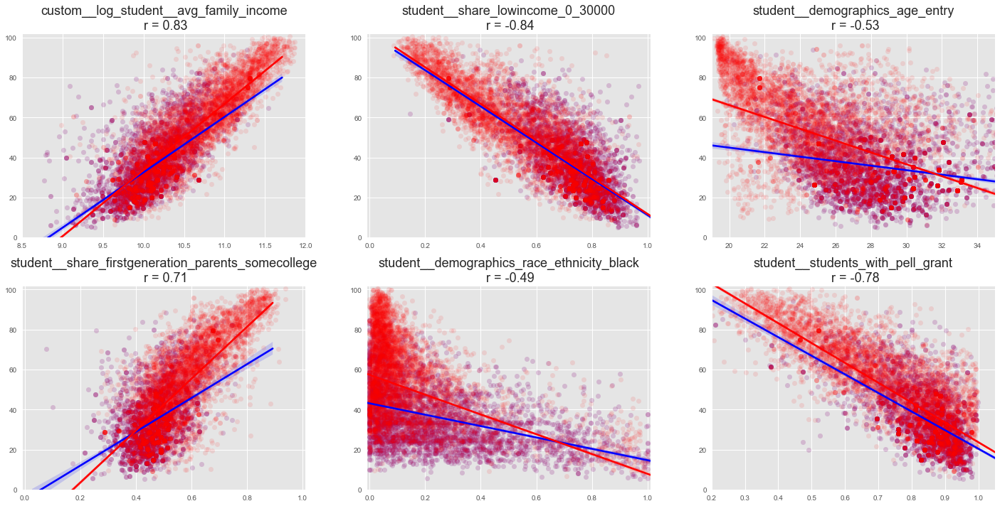

In [761]:
profit = df[df.school__ownership == 'Private for-profit']
temp = ["custom__log_student__avg_family_income", "student__share_lowincome_0_30000", 
        'student__demographics_age_entry', "student__share_firstgeneration_parents_somecollege" ,
        "student__demographics_race_ethnicity_black", "student__students_with_pell_grant"]

fig, axes = plt.subplots(2,3, figsize=(20,10))
ax = axes.ravel()
for i in range(len(temp)):
    sns.regplot(profit[temp[i]], profit['repayment_rate'], scatter_kws={'alpha':0.1}, color='blue',ax=ax[i])
    sns.regplot(df[temp[i]], df['repayment_rate'], scatter_kws={'alpha':0.1}, color='red',ax=ax[i])

    ax[i].set_title('{0}\n r = {1:.2f}'.format(temp[i], 
                                            stats.pearsonr(df[temp[i]].fillna(df[temp[i]].mean()), df['repayment_rate'])[0]),
                    size=18)
    ax[i].set_xlim(-.01,1.01)
    ax[i].set_ylim(0,102)
    ax[i].xaxis.label.set_visible(False)
    ax[i].yaxis.label.set_visible(False)
ax[5].set_xlim(0.2,1.05) 
ax[2].set_xlim(19,35)  
ax[0].set_xlim(8.5,12)

fig.tight_layout()

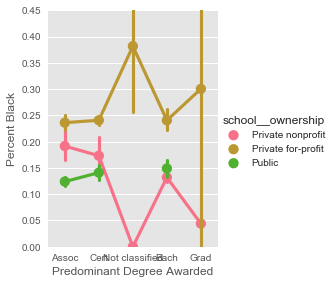

In [789]:
g = sns.factorplot('school__degrees_awarded_predominant', 'student__demographics_race_ethnicity_black', hue='school__ownership', 
               data=df, ci=None)
(g.set_axis_labels("Predominant Degree Awarded", "Percent Black")
 .set_xticklabels(["Assoc", "Cert", "Not classified", 'Bach', 'Grad'])
 .set_titles("{col_name} {col_var}")
 .set(ylim=(0, 0.45))
 .despine(left=True))

In [785]:
df['school__degrees_awarded_predominant'].unique()

array(["Predominantly associate's-degree granting",
       'Predominantly certificate-degree granting', 'Not classified',
       "Predominantly bachelor's-degree granting",
       'Entirely graduate-degree granting'], dtype=object)

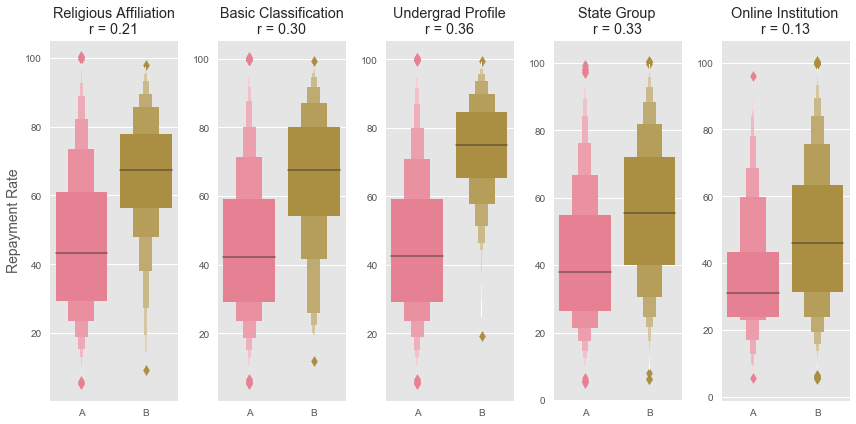

In [757]:
temp = ['custom__religious_high', 'custom__carnegie_basic_high', 'custom__carnegie_undergrad_high', "custom__school_state_high",
       "custom__school_online"]

fig, axes = plt.subplots(1, 5, figsize=(12,6))
ax = axes.ravel()

for i in range(len(ax)):
    sns.lvplot(df[temp[i]].astype('category'), df["repayment_rate"], ax=ax[i])
    ax[i].xaxis.label.set_visible(False)
    ax[i].set_xticklabels(['A', 'B'])
ax[0].set_ylabel('Repayment Rate', size=14)    
ax[0].set_title("Religious Affiliation\nr = {:.2f}".format(stats.pearsonr(df[temp[0]].fillna(df[temp[0]].mean()),
                                                                      df['repayment_rate'])[0]))

ax[1].yaxis.label.set_visible(False)
ax[1].set_title("Basic Classification\nr = {:.2f}".format(stats.pearsonr(df[temp[1]].fillna(df[temp[1]].mean()),
                                                                      df['repayment_rate'])[0]))

ax[2].yaxis.label.set_visible(False)
ax[2].set_title("Undergrad Profile\nr = {:.2f}".format(stats.pearsonr(df[temp[2]].fillna(df[temp[2]].mean()),
                                                                      df['repayment_rate'])[0]))
ax[3].yaxis.label.set_visible(False)
ax[3].set_title("State Group\nr = {:.2f}".format(stats.pearsonr(df[temp[3]].fillna(df[temp[3]].mean()),
                                                                      df['repayment_rate'])[0]))
ax[4].yaxis.label.set_visible(False)
ax[4].set_title("Online Institution\nr = {:.2f}".format(stats.pearsonr(df[temp[4]].fillna(df[temp[4]].mean()),
                                                                      df['repayment_rate'])[0]))
fig.tight_layout()

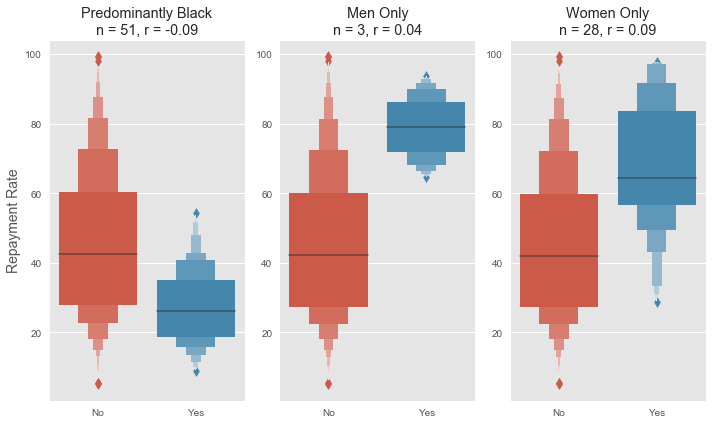

In [616]:
temp = ["school__minority_serving_predominantly_black", "school__men_only", "school__women_only", "repayment_rate"]

foo = df.loc[:, temp].dropna(axis=0)


fig, axes = plt.subplots(1, 3, figsize=(10,6))
ax = axes.ravel()

for i in range(len(ax)-1):
    sns.lvplot(foo[temp[i]].astype('category'), foo["repayment_rate"], ax=ax[i])
    ax[i].xaxis.label.set_visible(False)
    ax[i].set_xticklabels(['No', 'Yes'])
    
ax[0].set_ylabel('Repayment Rate', size=14)    
ax[0].set_title("Predominantly Black\nn = 51, r = {:.2f}".format(stats.pearsonr(foo[temp[0]],
                                                                      foo['repayment_rate'])[0]))

ax[1].yaxis.label.set_visible(False)
ax[1].set_title("Men Only\nn = 3, r = {:.2f}".format(stats.pearsonr(foo[temp[1]],
                                                                      foo['repayment_rate'])[0]))
sns.lvplot(foo["school__women_only"].astype('category'), foo["repayment_rate"], ax=ax[2])

ax[2].yaxis.label.set_visible(False)
ax[2].set_title("Women Only\nn = 28, r = {:.2f}".format(stats.pearsonr(foo["school__women_only"],
                                                                      foo['repayment_rate'])[0]))
ax[2].set_xticklabels(['No', 'Yes'])
ax[2].xaxis.label.set_visible(False)
fig.tight_layout()

(-0.20774737601979945, 1.7290187329872911e-85)

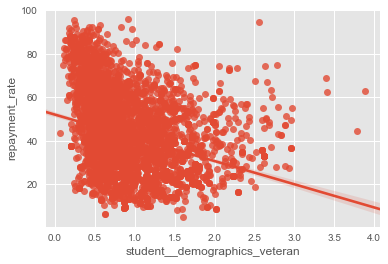

In [634]:
bar = df['student__demographics_veteran'].map(lambda x:np.log(x*100+1))


sns.regplot(bar, df['repayment_rate'])
#
stats.pearsonr(bar.fillna(bar.mean()), df['repayment_rate'])

KeyError: 'custom__log_school__branches'

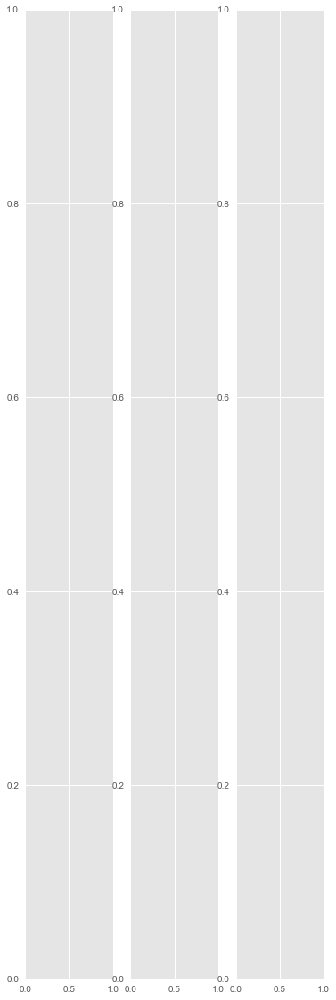

In [492]:

fig, axes = plt.subplots(1, 3, figsize=(6,20))
ax = axes.ravel()
for i in range(len(temp)):
    sns.regplot(df[temp[i]], df['repayment_rate'], color='#fb7d07', scatter_kws={'alpha':0.3}, ax=ax[i])
    ax[i].set_title('{0}: {1}\n r = {2:.2f}'.format(i+1, temp[i], 
                                            stats.pearsonr(df[temp[i]].fillna(df[temp[i]].mean()), df['repayment_rate'])[0]),
                    size=21)
    #ax[i].set_xlim(-.01,1.01)
    ax[i].set_ylim(0,102)
    ax[i].xaxis.label.set_visible(False)
    ax[i].yaxis.label.set_visible(False)
    ax[1].set_xlim(0, 15000)
fig.tight_layout()